In [1]:
import xarray
import fsspec
import numpy as np
import s3fs
import proplot
import os

from matplotlib import pyplot as plt
import pandas

/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/_collections_abc.py:841: MatplotlibDeprecationWarning: 
The examples.directory rcparam was deprecated in Matplotlib 3.0 and will be removed in 3.2. In the future, examples will be found relative to the 'datapath' directory.
  self[key] = other[key]


In [2]:
#@dask.delayed
def s3open(path):
    fs = s3fs.S3FileSystem(anon=True, default_fill_cache=False, 
                           config_kwargs = {'max_pool_connections': 50})
    return s3fs.S3Map(path, s3=fs)

In [3]:
def create_profile_index(wod_dataset,variable_name):
    
    cast_row_size = wod_dataset[variable_name + '_row_size'].values
    
    
    cast_counter = cast_row_size.cumsum().astype(int)
    
    cast_counter = np.concatenate([np.zeros([1],dtype=int),cast_counter])
    cast_index   = xarray.full_like(wod_dataset[variable_name + '_obs'],fill_value=0,dtype=int)
    
    #unique_cast_for_variable = 
    cast_row_counter = 0
    for i_cast in range(0,wod_dataset['casts'].size):

        current_cast_row_size = cast_row_size[i_cast] #.astype(int)
        #print(current_cast_row_size)
        if not np.isnan(current_cast_row_size):
            
            
            cast_index[cast_row_counter:cast_row_counter+int(current_cast_row_size)] =  wod_dataset['casts'][i_cast].astype(int)
            cast_row_counter = cast_row_counter + int(current_cast_row_size)
            
            
    return cast_index

In [5]:
def filter_variables_by_lat_lon(wod_dataset,lon_min,lon_max,lat_min,lat_max,variable_name):
    
    #i_obs_type = 1
    casts_in_box = ( (wod_dataset['lat']>=LATITUDE_LIM_SOUTH) & (wod_dataset['lat']<=LATITUDE_LIM_NORTH) & 
                    (wod_dataset['lon']>=LONGITUDE_LIM_WEST)  & (wod_dataset['lon']<=LONGITUDE_LIM_EAST)  ) 

    casts_in_box = wod_dataset['casts'][meets_condition]

    latitude_for_casts = data_container_for_year[i_obs_type]['lat'].sel(casts=casts_in_box)
    longitude_for_casts = data_container_for_year[i_obs_type]['lon'].sel(casts=casts_in_box)
    time_for_casts


    cast_indicies        = wod_dataset[i_obs_type][variable_name + '_cast_index'].isin(casts_in_box)
    casts_data           = wod_dataset[i_obs_type][variable_name][cast_indicies]
    temperature_cast_index_for_cast = wod_dataset[i_obs_type][variable_name + '_cast_index'][cast_indicies]

    filtered_variable_dataset = temperature_casts_to_get.to_dataset() 

    return filtered_variable_dataset
    
    
#z_casts_to_get         = data_container_for_year[i_obs_type]['z_cast_index'].isin(casts_in_box)
#z_for_casts            = data_container_for_year[i_obs_type]['z'][z_casts_to_get]
#z_cast_index_for_cast  = data_container_for_year[i_obs_type]['z_cast_index'][z_casts_to_get]

    

In [6]:
START_YEAR = 2015
END_YEAR   = 2015

#year = 2018
obs_type = ['ctd','xbt','pfl','mrb','gld','drb'] #,'gld']
base_s3_url = 's3://noaa-wod-pds'

data_container = []

for i_year in range(START_YEAR,END_YEAR+1):

    data_container_for_year = []
    for i_obs_type in obs_type:
        url = base_s3_url + '/' + str(i_year) + '/wod_' + i_obs_type + '_' + str(i_year) + '.nc' #_pfl_2018.nc'
        print(url)
        fs = s3fs.S3FileSystem(anon=True)
        file_obj = fs.open(url)
#ncfile = fsspec.open(url)
        ds = xarray.open_dataset(file_obj,engine='h5netcdf')
        data_container_for_year.append(ds)
    data_container.append(data_container_for_year)

#ds.air_temperature_at_2_metres.encoding


s3://noaa-wod-pds/2015/wod_ctd_2015.nc
s3://noaa-wod-pds/2015/wod_xbt_2015.nc
s3://noaa-wod-pds/2015/wod_pfl_2015.nc
s3://noaa-wod-pds/2015/wod_mrb_2015.nc
s3://noaa-wod-pds/2015/wod_gld_2015.nc
s3://noaa-wod-pds/2015/wod_drb_2015.nc


In [ ]:
data_container[0][0].load()

In [7]:
for i_year in range(START_YEAR,END_YEAR+1):
    year_index = i_year-START_YEAR
    print(i_year)
    for i_obs_type in range(0,len(obs_type)):

        print(obs_type[i_obs_type])
        cast_temperature_index = create_profile_index(data_container[year_index][i_obs_type],'Temperature')
        cast_depth_index       = create_profile_index(data_container[year_index][i_obs_type],'z')
        #dsadsa
        data_container[year_index][i_obs_type]['Temperature_cast_index'] = cast_temperature_index
        data_container[year_index][i_obs_type]['z_cast_index']           = cast_depth_index

2005
ctd
xbt
pfl
mrb


ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3552, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/tmp/ipykernel_30005/3503757873.py", line 8, in <module>
    cast_depth_index       = create_profile_index(data_container[year_index][i_obs_type],'z')
  File "/tmp/ipykernel_30005/168401065.py", line 3, in create_profile_index
    cast_row_size = wod_dataset[variable_name + '_row_size'].values
  File "/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/xarray/core/dataarray.py", line 628, in values
    return self.variable.values
  File "/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/xarray/core/variable.py", line 512, in values
    return _as_array_or_item(self._data)
  File "/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/xarray/core/variable.py", line 274, in _

TypeError: object of type 'NoneType' has no len()

In [7]:
data_container_for_year[1]['time']

<xarray.DataArray 'time' (casts: 15879)>
array(['2018-01-01T00:05:00.000002048', '2018-01-01T00:38:59.999860736',
       '2018-01-01T01:48:59.999770624', ..., '2018-12-31T23:31:59.998169088',
       '2018-12-31T23:22:00.000457728', '2018-12-31T23:58:00.003548160'],
      dtype='datetime64[ns]')
Coordinates:
    lat      (casts) float32 -55.7 -55.8 -56.0 -55.9 ... -17.31 -55.4 -55.5
    lon      (casts) float32 -64.6 -64.55 -64.46 -64.5 ... 118.5 -64.85 -64.81
    time     (casts) datetime64[ns] 2018-01-01T00:05:00.000002048 ... 2018-12...
Dimensions without coordinates: casts
Attributes:
    standard_name:  time
    long_name:      time

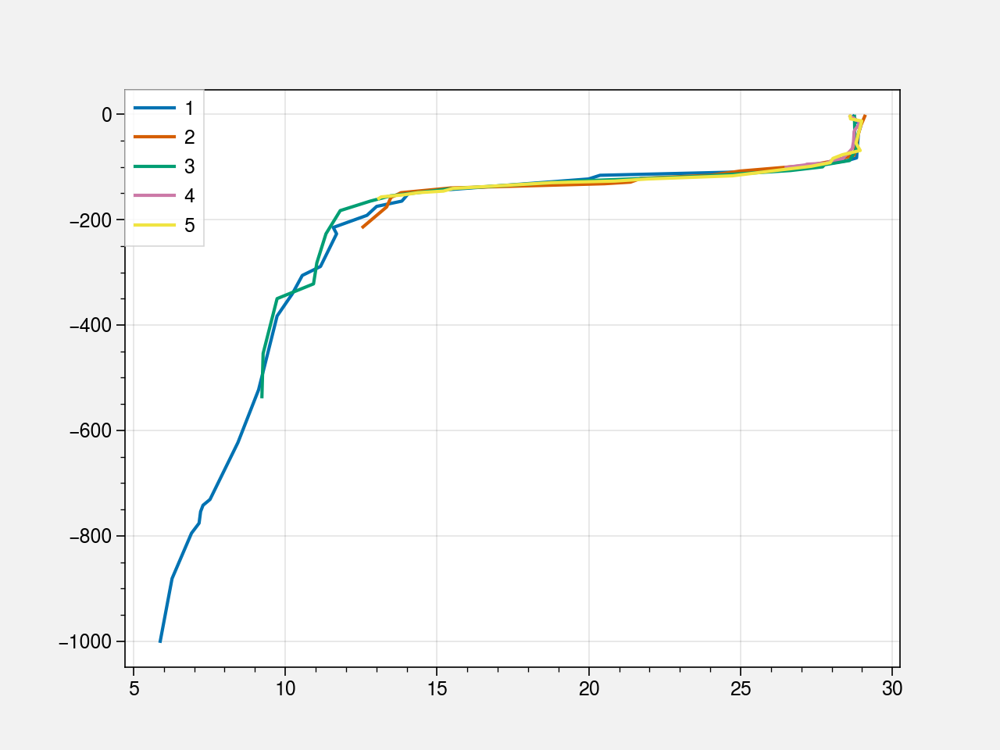

In [68]:
i_obs_type = 0
for i_year in range(START_YEAR,END_YEAR+1):
    
    for i_cast in range(1,6):
    T_indices = data_container_for_year[i_obs_type]['Temperature_cast_index'].isin(i_cast)
    T_profile = data_container_for_year[i_obs_type]['Temperature'][T_indices]
    
    Z_indices = data_container_for_year[i_obs_type]['z_cast_index'].isin(i_cast)
    Z_profile = data_container_for_year[i_obs_type]['z'][Z_indices]
    
    
    #T_profile = data_container_for_year[i_obs_type].sel(Temperature_cast_index==i_cast)
    #Z_profile = z_for_casts[i_obs_type].sel(z_cast_index ==i_cast)
    plt.plot(T_profile,-Z_profile,label=str(i_cast))
plt.legend()

In [12]:
len(data_container)

16

Text(0.02, 1.01, 'WOD for year 2018')

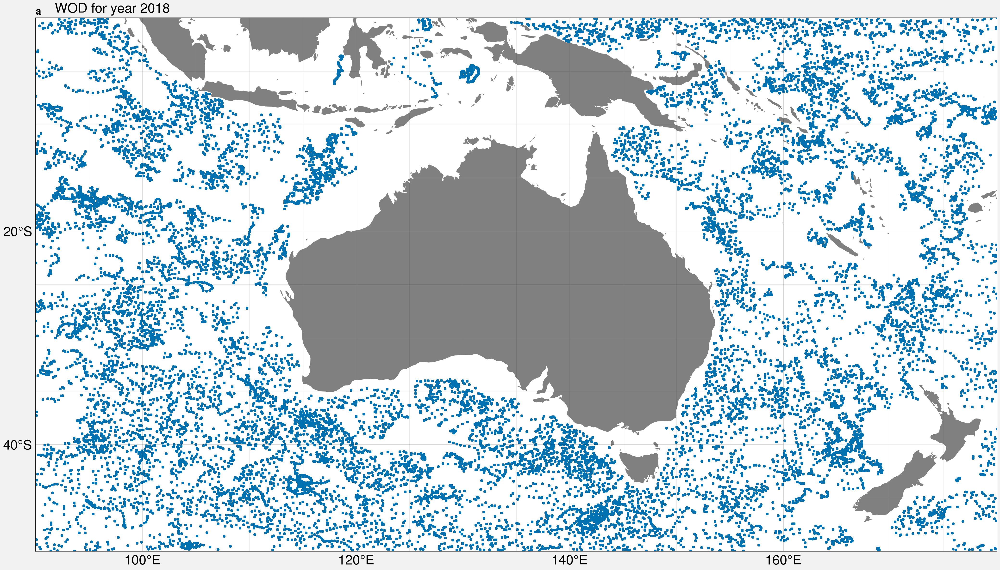

In [19]:
LONGITUDE_LIM_EAST = 180
LONGITUDE_LIM_WEST = 90

LATITUDE_LIM_SOUTH = -50
LATITUDE_LIM_NORTH = 0 
#obs_type = ['ctd','xbt','pfl','osd','mrb','gld','drb'] #,'gld']


year_to_get = 2018
i_year_to_get = year_to_get-START_YEAR

data_container_for_year = data_container[i_year_to_get]
i_obs_type = 2

meets_condition = ( (data_container_for_year[i_obs_type]['lat']>=LATITUDE_LIM_SOUTH) & (data_container_for_year[i_obs_type]['lat']<=LATITUDE_LIM_NORTH) 
                  & (data_container_for_year[i_obs_type]['lon']>=LONGITUDE_LIM_WEST) & (data_container_for_year[i_obs_type]['lon']<=LONGITUDE_LIM_EAST)  ) 


casts_in_box = data_container_for_year[i_obs_type]['casts'][meets_condition]


temperature_casts_to_get           = data_container_for_year[i_obs_type]['Temperature_cast_index'].isin(casts_in_box)
temperature_for_casts              = data_container_for_year[i_obs_type]['Temperature'][temperature_casts_to_get]
temperature_cast_index_for_cast    = data_container_for_year[i_obs_type]['Temperature_cast_index'][temperature_casts_to_get]

latitude_for_casts   = data_container_for_year[i_obs_type]['lat'].sel(casts=temperature_cast_index_for_cast)
longitude_for_casts  = data_container_for_year[i_obs_type]['lon'].sel(casts=temperature_cast_index_for_cast)


z_casts_to_get         = data_container_for_year[i_obs_type]['z_cast_index'].isin(casts_in_box)
z_for_casts            = data_container_for_year[i_obs_type]['z'][z_casts_to_get]
z_cast_index_for_cast  = data_container_for_year[i_obs_type]['z_cast_index'][z_casts_to_get]


proplot.rc['abc.size'] = 15
LONGITUDE_LIM_EAST = 180
LONGITUDE_LIM_WEST = 90

LATITUDE_LIM_SOUTH = -50
LATITUDE_LIM_NORTH = 0 
#obs_type = ['ctd','xbt','pfl','osd','mrb','gld','drb'] #,'gld']

proplot.rc.reso = 'med'  # use higher res for zoomed in geographic features
#basemap = pplt.Proj('cyl', lonlim=(-20, 180), latlim=(-10, 50), basemap=True)
fig, axs = proplot.subplots(nrows=1, proj=('cyl'),axwidth=20)
axs.format(
    land=True, labels=True, lonlines=20, latlines=20,
    gridminor=True,landcolor='grey', abc='a)'
)


obs_type_label = ['CTD','XBT','Profiling float','Ocean Station','Mooring','Glider']

#for i_obs_type in [2,0,1,3,4,5]:

axs[0].scatter(longitude_for_casts,latitude_for_casts,s=10) #,label=obs_type_label[i_obs_type]) #,label=i_WMO_cruise,s=10) #,c=WMO_id,cmap='jet') #,latitude_for_casts)
axs[0].format(lonlim=(90, 180), latlim=(-50, 0), labels=True,gridlabelsize=20)
#axs[0].legend(loc='lower left',ncols=1,fontsize=15,framealpha=1.0)
axs[0].annotate('WOD for year ' + str(year_to_get), xy=(0.02, 1.01), xycoords="axes fraction",fontsize=20)




In [52]:
longitude_for_casts

<xarray.DataArray 'lon' (Temperature_obs: 5105873)>
array([118.3  , 118.3  , 118.3  , ..., 118.516, 118.516, 118.516],
      dtype=float32)
Coordinates:
    lat      (Temperature_obs) float32 -17.83 -17.83 -17.83 ... -17.31 -17.31
    lon      (Temperature_obs) float32 118.3 118.3 118.3 ... 118.5 118.5 118.5
    time     (Temperature_obs) datetime64[ns] ...
Dimensions without coordinates: Temperature_obs
Attributes:
    standard_name:  longitude
    long_name:      longitude
    units:          degrees_east

In [53]:
latitude_for_casts

<xarray.DataArray 'lat' (Temperature_obs: 5105873)>
array([-17.8333, -17.8333, -17.8333, ..., -17.313 , -17.313 , -17.313 ],
      dtype=float32)
Coordinates:
    lat      (Temperature_obs) float32 -17.83 -17.83 -17.83 ... -17.31 -17.31
    lon      (Temperature_obs) float32 118.3 118.3 118.3 ... 118.5 118.5 118.5
    time     (Temperature_obs) datetime64[ns] ...
Dimensions without coordinates: Temperature_obs
Attributes:
    standard_name:  latitude
    long_name:      latitude
    units:          degrees_north

In [50]:
temperature_cast_index_for_cast

<xarray.DataArray 'Temperature_cast_index' (Temperature_obs: 5105873)>
array([  133,   133,   133, ..., 15876, 15876, 15876])
Dimensions without coordinates: Temperature_obs

32
93
158


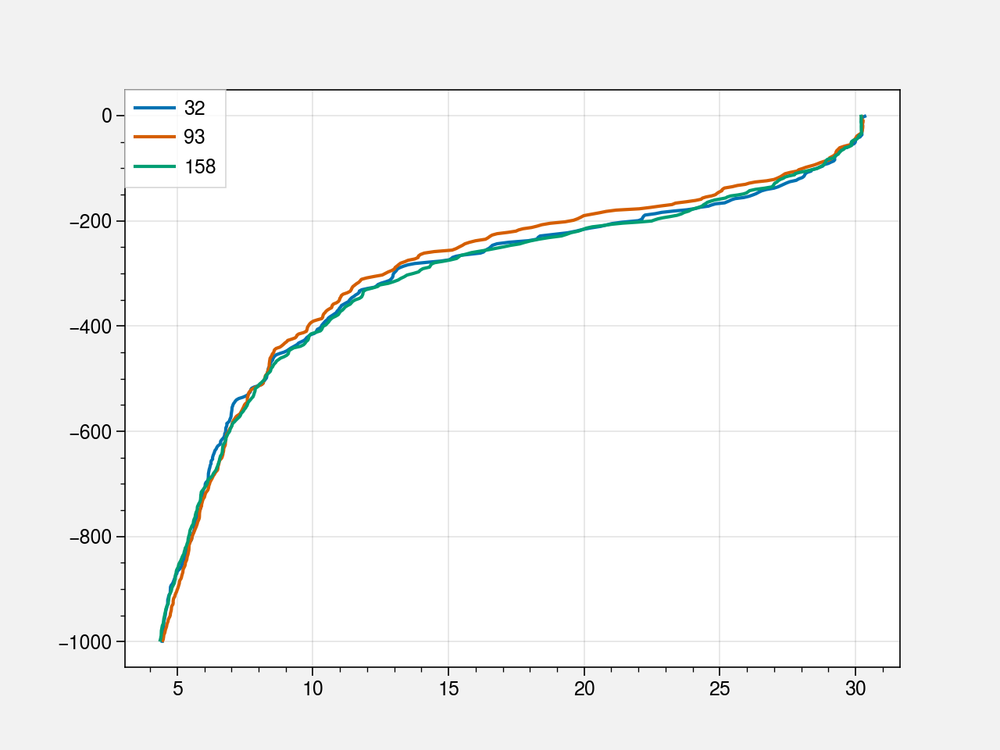

In [10]:
for i_cast in range(0, 3): #casts_in_box.size):
    cast_number = casts_in_box[i_cast]
    print(cast_number.values)
    
    
    T_profile = temperature_for_casts[temperature_cast_index_for_cast==cast_number]
    Z_profile = z_for_casts[z_cast_index_for_cast ==cast_number ]
    plt.plot(T_profile,-Z_profile,label=str(cast_number.values))
plt.legend()

In [9]:
topography_file_path = '/tube1/cha674/ETOPO'
topography_file_name = 'ETOPO1_Ice_g_gmt4.grd'

etopo_dataset = xarray.open_dataset(os.path.join(topography_file_path,topography_file_name))


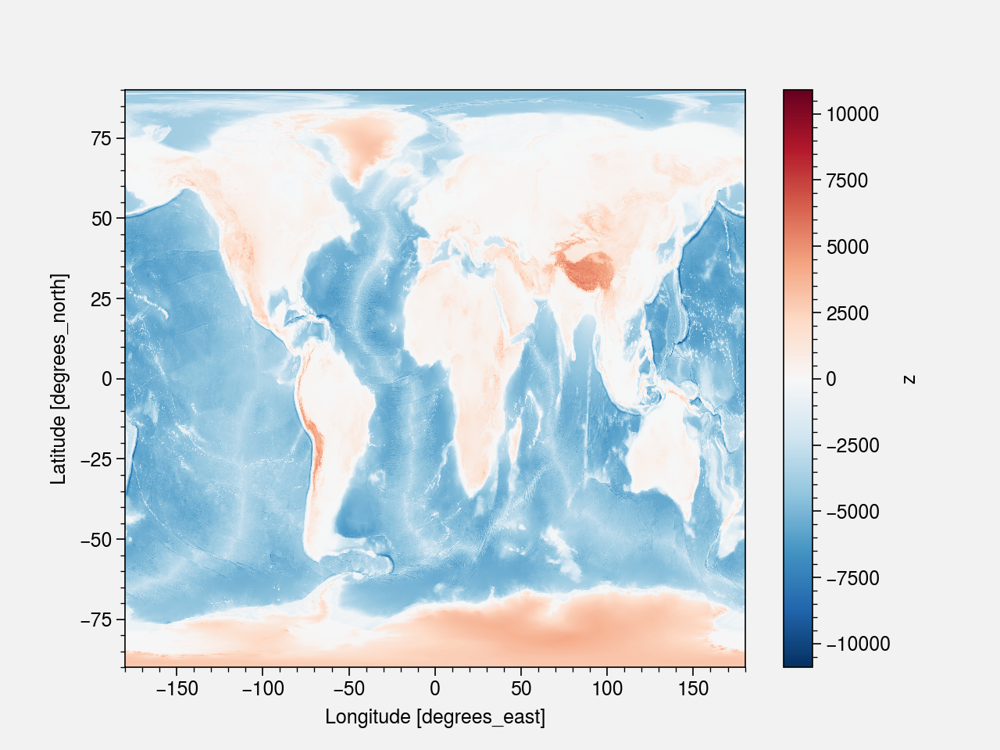

In [40]:
etopo_dataset['z'].plot()

In [10]:
topo = etopo_dataset['z'].sel(x=slice(LONGITUDE_LIM_WEST,LONGITUDE_LIM_EAST),y=slice(LATITUDE_LIM_SOUTH,LATITUDE_LIM_NORTH)).load()

WOD_XBT_CTD_data_scatter_for_year_2005
WOD_XBT_CTD_data_scatter_for_year_2006
WOD_XBT_CTD_data_scatter_for_year_2007
WOD_XBT_CTD_data_scatter_for_year_2008
WOD_XBT_CTD_data_scatter_for_year_2009
WOD_XBT_CTD_data_scatter_for_year_2010
WOD_XBT_CTD_data_scatter_for_year_2011
WOD_XBT_CTD_data_scatter_for_year_2012
WOD_XBT_CTD_data_scatter_for_year_2013
WOD_XBT_CTD_data_scatter_for_year_2014
WOD_XBT_CTD_data_scatter_for_year_2015
WOD_XBT_CTD_data_scatter_for_year_2016
WOD_XBT_CTD_data_scatter_for_year_2017
WOD_XBT_CTD_data_scatter_for_year_2018
WOD_XBT_CTD_data_scatter_for_year_2019
WOD_XBT_CTD_data_scatter_for_year_2020


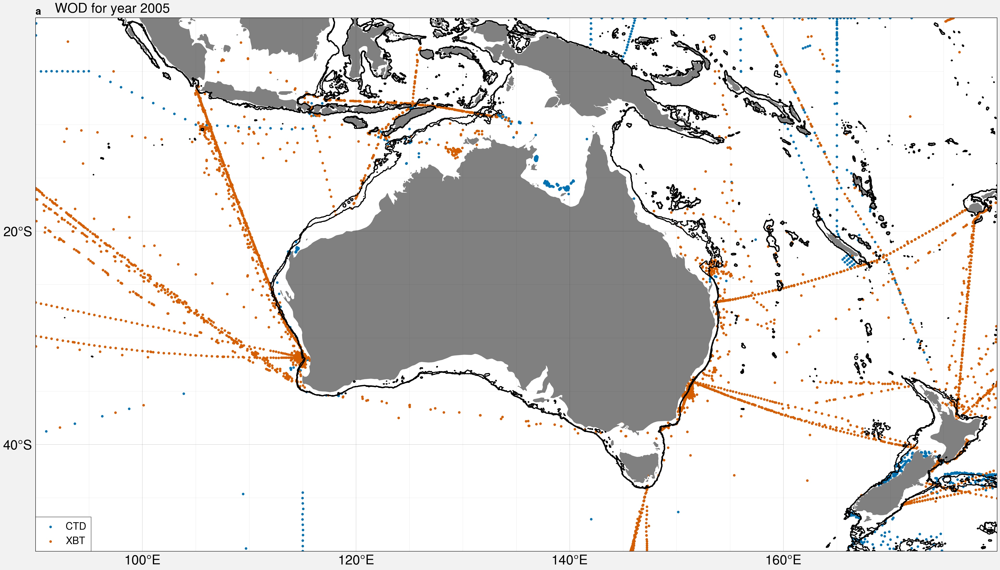

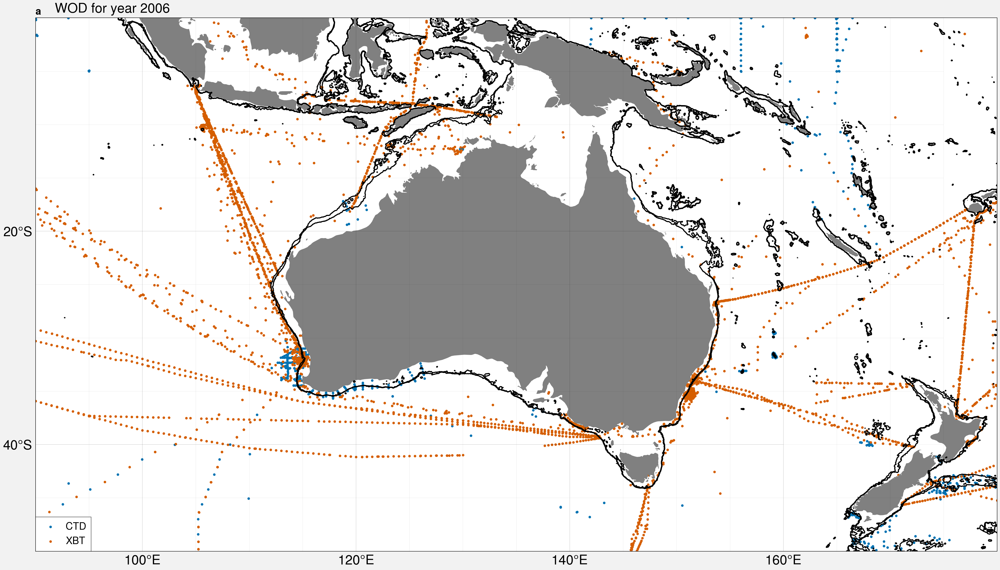

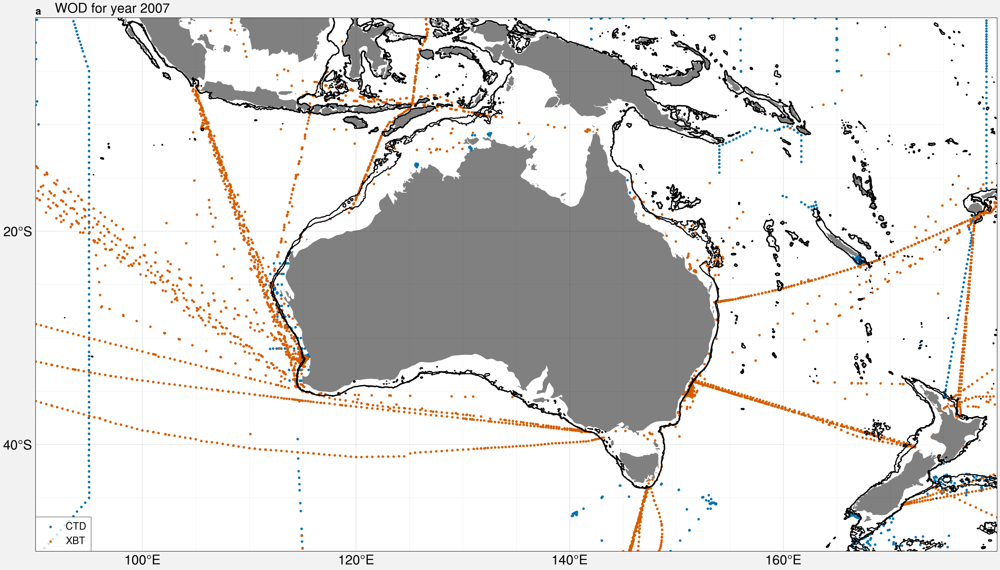

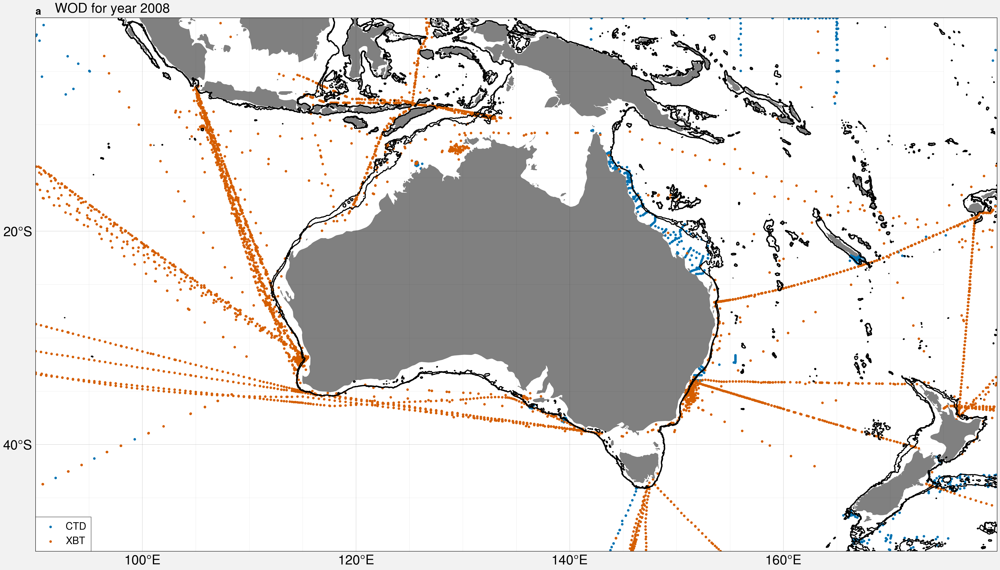

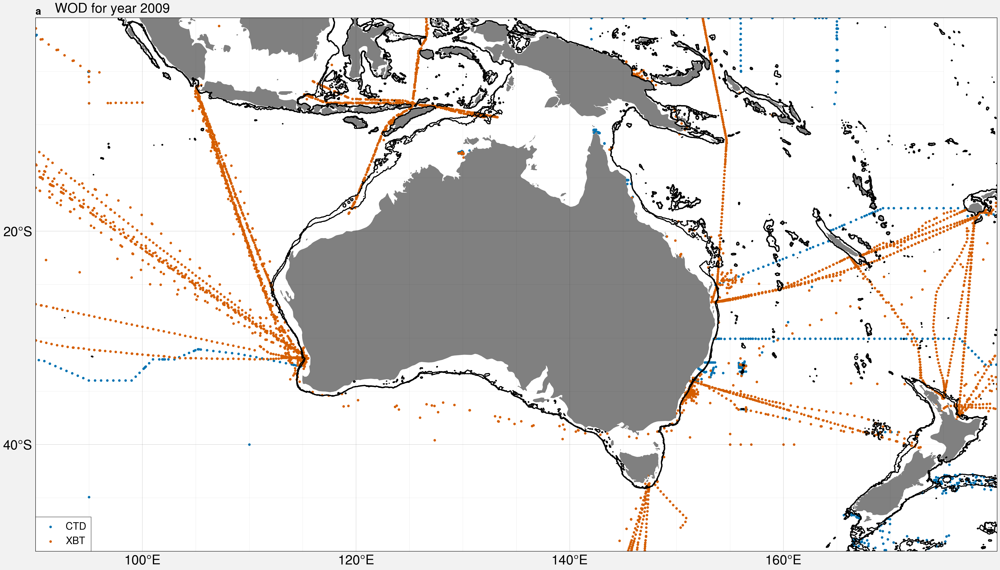

...

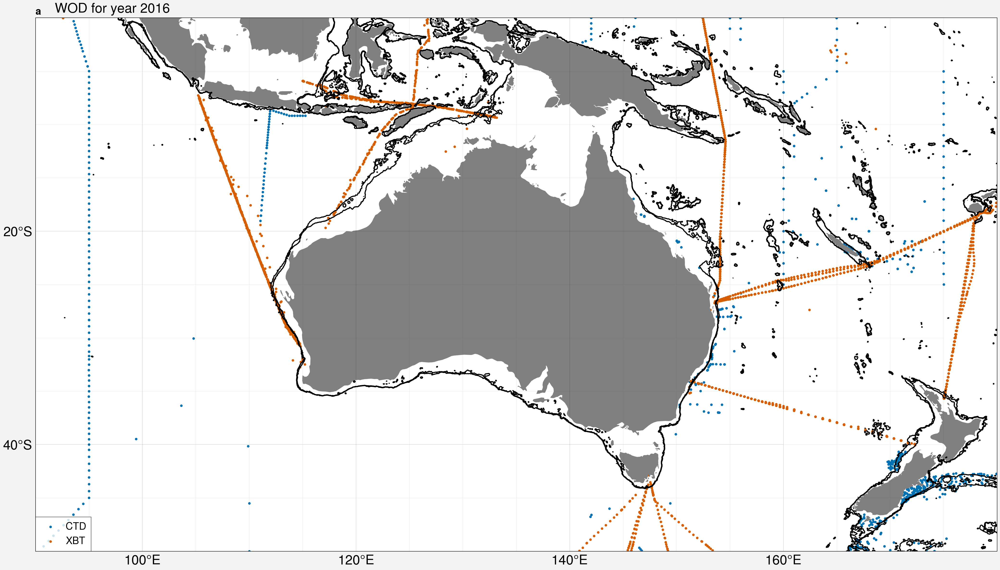

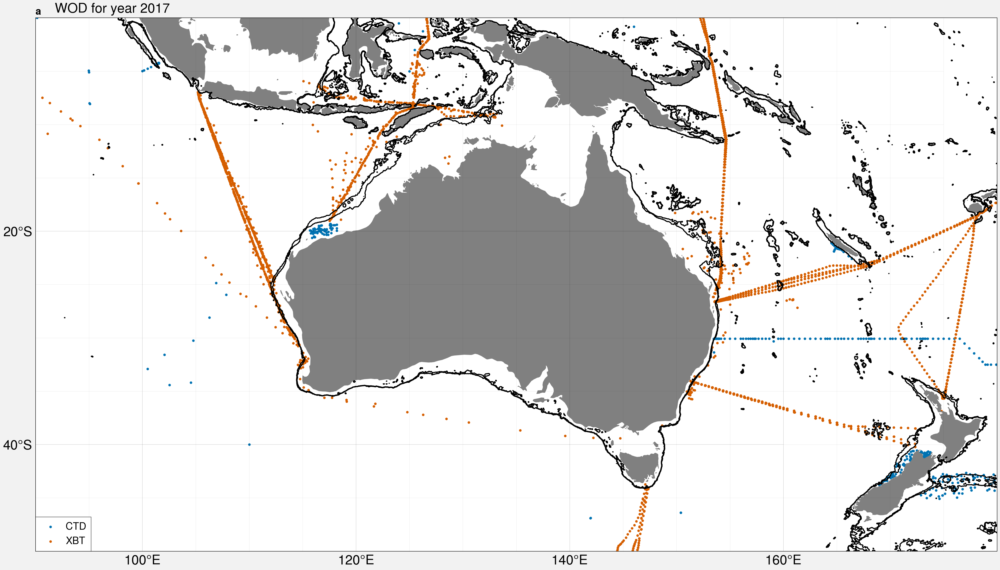

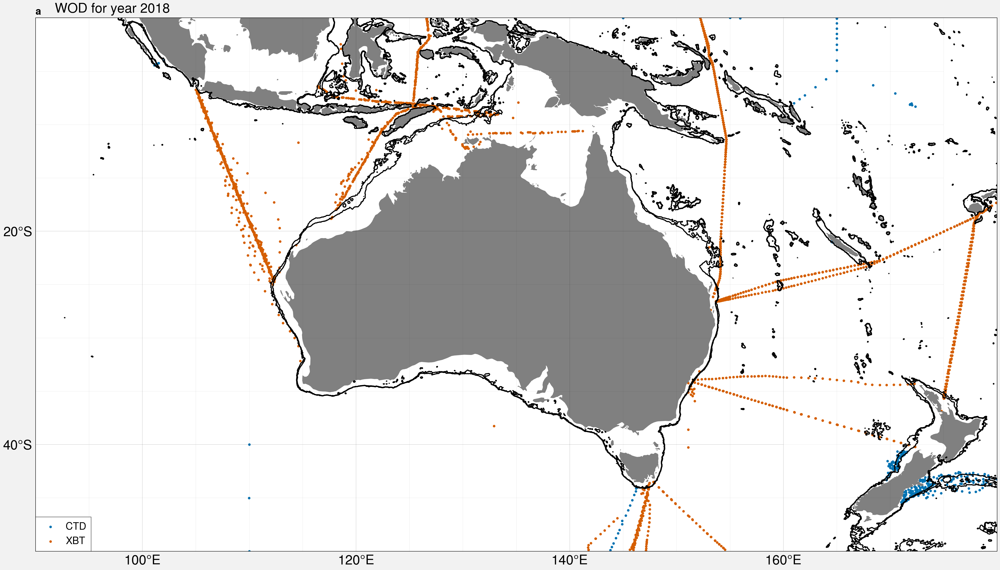

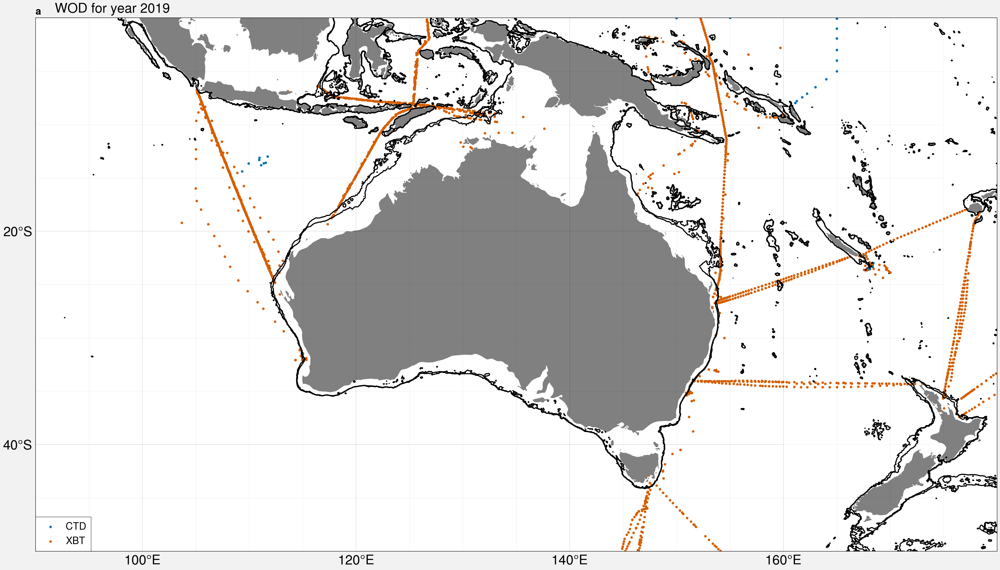

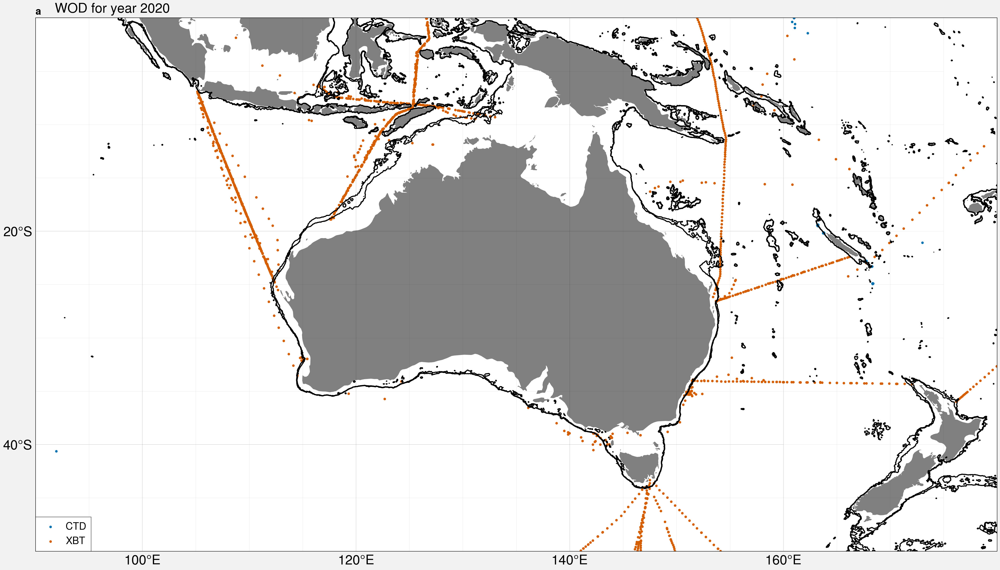

In [15]:
import proplot as pplt
pplt.rc['abc.size'] = 15
LONGITUDE_LIM_EAST = 180
LONGITUDE_LIM_WEST = 90

LATITUDE_LIM_SOUTH = -50
LATITUDE_LIM_NORTH = 0 
#obs_type = ['ctd','xbt','pfl','osd','mrb','gld','drb'] #,'gld']


#i_obs_type = 2


pplt.rc.reso = 'med'  # use higher res for zoomed in geographic features
#basemap = pplt.Proj('cyl', lonlim=(-20, 180), latlim=(-10, 50), basemap=True)
obs_type_label = ['CTD','XBT','Profiling float','Mooring','Glider','Drifting Buoy']

for i_year in range(START_YEAR,END_YEAR+1):
    fig, axs = pplt.subplots(nrows=1, proj=('cyl'),axwidth=20)
    axs.format(
        land=True, labels=True, lonlines=20, latlines=20,
        gridminor=True,landcolor='grey', abc='a)'
   )


    i_year_index = i_year-START_YEAR

    data_container_for_year = data_container[i_year_index]

    for i_obs_type in [0,1]: #[2,0,1,3,4,5]:
        meets_condition = ( (data_container_for_year[i_obs_type]['lat']>=LATITUDE_LIM_SOUTH) & (data_container_for_year[i_obs_type]['lat']<=LATITUDE_LIM_NORTH) 
                          & (data_container_for_year[i_obs_type]['lon']>=LONGITUDE_LIM_WEST) & (data_container_for_year[i_obs_type]['lon']<=LONGITUDE_LIM_EAST)  ) 


        casts_in_box = data_container_for_year[i_obs_type]['casts'][meets_condition]
    
        latitude_profile = data_container_for_year[i_obs_type]['lat'].sel(casts=casts_in_box)
        longitude_profile = data_container_for_year[i_obs_type]['lon'].sel(casts=casts_in_box)
    
        axs[0].contour(topo['x'],topo['y'],-topo,levels=[200,500],colors='black')
        axs[0].scatter(longitude_profile,latitude_profile,s=10,label=obs_type_label[i_obs_type]) #,label=i_WMO_cruise,s=10) #,c=WMO_id,cmap='jet') #,latitude_for_casts)
    
        axs[0].format(lonlim=(90, 180), latlim=(-50, 0), labels=True,gridlabelsize=20)

    #T_profile = temperature_for_casts[temperature_cast_index_for_cast==cast_number]
    #Z_profile = z_for_casts[z_cast_index_for_cast ==cast_number ]
    #plt.plot(T_profile,-Z_profile,label=str(cast_number.values))
    axs[0].legend(loc='lower left',ncols=1,fontsize=15,framealpha=1.0)
    axs[0].annotate('WOD for year ' + str(i_year), xy=(0.02, 1.01), xycoords="axes fraction",fontsize=20)

    figure_path = './Figures'
    figure_name = 'WOD_XBT_CTD_data_scatter_for_year_' + str(i_year)                                                
    print(figure_name)
    fig.savefig(os.path.join(figure_path,figure_name + '.png'), dpi=400)

    
#fig.savefig(os.path.join(figure_path,figure_name + '.eps'), dpi=400)

#plt.legend()


In [62]:
i_WMO_cruise

b'AU005779'

In [50]:
bad_wmo_index  = np.where(np.isnan(WMO_id))
print(WMO_id[bad_wmo_index])

<xarray.DataArray 'WMO_ID' (casts: 88035)>
array([nan, nan, nan, ..., nan, nan, nan])
Coordinates:
    lat      (casts) float32 -32.17 -32.17 -32.17 ... -33.09 -33.08 -33.08
    lon      (casts) float32 152.6 152.6 152.6 152.6 ... 151.7 151.7 151.7 151.7
    time     (casts) datetime64[ns] 2018-02-04T22:07:30 ... 2018-12-19T00:59:...
Dimensions without coordinates: casts
Attributes:
    long_name:  WMO_identification_code


Getting data for:  CTD
Getting data for year:  2005
Getting data for year:  2006
Getting data for year:  2007
Getting data for year:  2008
Getting data for year:  2009
Getting data for year:  2010
Getting data for year:  2011
Getting data for year:  2012
Getting data for year:  2013
Getting data for year:  2014
Getting data for year:  2015
Getting data for year:  2016
Getting data for year:  2017
Getting data for year:  2018
Getting data for year:  2019
Getting data for year:  2020
Getting data for:  XBT
Getting data for year:  2005
Getting data for year:  2006
Getting data for year:  2007
Getting data for year:  2008
Getting data for year:  2009
Getting data for year:  2010
Getting data for year:  2011
Getting data for year:  2012
Getting data for year:  2013
Getting data for year:  2014
Getting data for year:  2015
Getting data for year:  2016
Getting data for year:  2017
Getting data for year:  2018
Getting data for year:  2019
Getting data for year:  2020
Getting data for:  Profili

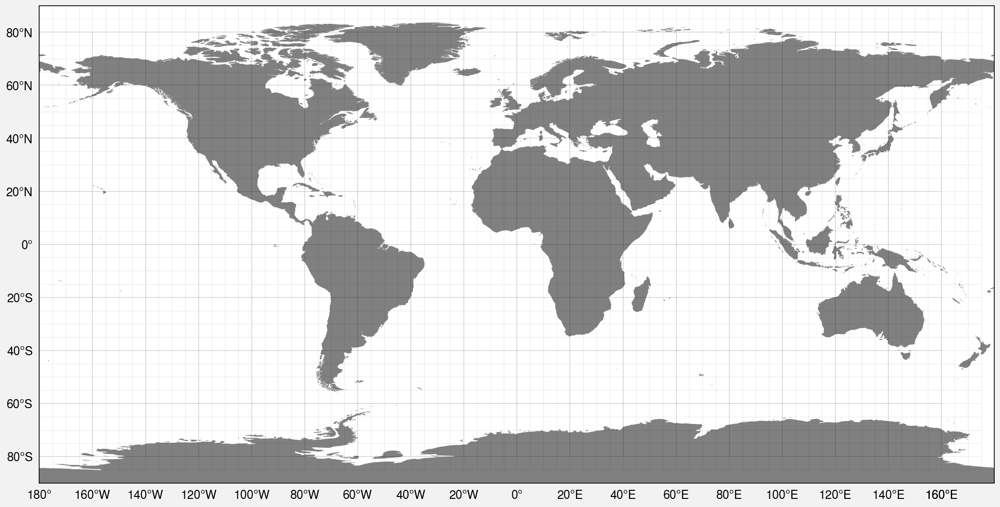

In [6]:
import proplot as pplt
from scipy import stats as scipy_stats
import matplotlib.colors as colors


LONGITUDE_LIM_EAST = 180
LONGITUDE_LIM_WEST = 90

LATITUDE_LIM_SOUTH = -50
LATITUDE_LIM_NORTH = 0 
#obs_type = ['ctd','xbt','pfl','osd','mrb','gld','drb'] #,'gld']

pplt.rc.reso = 'med'  # use higher res for zoomed in geographic features
basemap = pplt.Proj('cyl', lonlim=(-20, 180), latlim=(-10, 50), basemap=True)
fig, axs = pplt.subplots(nrows=1, proj=('cyl'),axwidth=10)
axs.format(
    land=True, labels=True, lonlines=20, latlines=20,
    gridminor=True,landcolor='grey' 
)


obs_type_label = ['CTD','XBT','Profiling float','Mooring','Glider']

delta_lat = 0.25
delta_lon = 0.25
lat_grid = np.arange(LATITUDE_LIM_SOUTH,LATITUDE_LIM_NORTH,delta_lat)
lon_grid = np.arange(LONGITUDE_LIM_WEST,LONGITUDE_LIM_EAST,delta_lon)
date_range  = np.arange(np.datetime64(str(START_YEAR) + "-01-01"), np.datetime64(str(END_YEAR+1) + "-01-01"), np.timedelta64(1, "D"))

obs_type_to_plot = [0,1,2,3,4]

obs_count_histogram = np.zeros([len(obs_type_to_plot),date_range.size-1,lat_grid.size-1,lon_grid.size-1])


for i_obs_type in obs_type_to_plot:
    print('Getting data for: ', obs_type_label[i_obs_type])
    #obs_count_histogram = np.zeros([date_range.size-1,lat_grid.size-1,lon_grid.size-1])


    for i_year in range(START_YEAR,END_YEAR+1):
        i_year_index = i_year-START_YEAR
        print('Getting data for year: ', i_year)
        data_container_for_year = data_container[i_year_index]
    
        meets_condition = ( (data_container_for_year[i_obs_type]['lat']>=LATITUDE_LIM_SOUTH) & (data_container_for_year[i_obs_type]['lat']<=LATITUDE_LIM_NORTH) 
                          & (data_container_for_year[i_obs_type]['lon']>=LONGITUDE_LIM_WEST) & (data_container_for_year[i_obs_type]['lon']<=LONGITUDE_LIM_EAST)  ) 

        if meets_condition.sum() != 0:
            casts_in_box    = data_container_for_year[i_obs_type]['casts'][meets_condition]

            longitude_for_casts = data_container_for_year[i_obs_type]['lon'].sel(casts=casts_in_box)
            latitude_for_casts  = data_container_for_year[i_obs_type]['lat'].sel(casts=casts_in_box)
            time_for_casts      = data_container_for_year[i_obs_type]['time'].sel(casts=casts_in_box)

    
    
            if i_year == START_YEAR:
                longitude_all_casts  =   longitude_for_casts.values
                latitude_all_casts   =   latitude_for_casts.values
                time_all_casts       =   time_for_casts.values 
            else:
                longitude_all_casts = np.concatenate([longitude_all_casts,longitude_for_casts.values])
                latitude_all_casts = np.concatenate([latitude_all_casts,latitude_for_casts.values])
                time_all_casts     = np.concatenate([time_all_casts,time_for_casts.values])

        
        
    for iT in range(0,date_range.size-1):
        #print('Time slice: ',date_range[iT], ' to ', date_range[iT+1] )
    
        idx_data_in_time_slice  = np.nonzero(np.logical_and(time_all_casts>=date_range[iT],time_all_casts<date_range[iT+1]) ) [0]
    
        if idx_data_in_time_slice.size !=0:
            time_data_in_time_slice = time_all_casts[idx_data_in_time_slice]
            lon_data_in_time_slice  = longitude_all_casts[idx_data_in_time_slice]
            lat_data_in_time_slice  = latitude_all_casts[idx_data_in_time_slice]
    
            returned_stats = scipy_stats.binned_statistic_2d(lon_data_in_time_slice, lat_data_in_time_slice, None, 'count', bins=[lon_grid, lat_grid])
            obs_count_histogram[i_obs_type,iT,:,:] = returned_stats.statistic.T
        
        
    np.savez('WOD_obs_histogram_' + str(START_YEAR) + '_' +str(END_YEAR+1) + '_' + str(obs_type_label[i_obs_type]) + '.npz',obs_count_hist=obs_count_histogram[i_obs_type,:,:,:])


In [12]:
obs_count_histogram.shape

(5, 5843, 199, 359)

In [39]:
meets_condition.sum()

<xarray.DataArray ()>
array(0)

In [37]:
data_container_for_year[i_obs_type]['lat']

<xarray.DataArray 'lat' (casts: 9161)>
array([56.54242 , 57.434242, 57.0964  , ..., 47.118343, 47.118984, 47.00655 ],
      dtype=float32)
Coordinates:
    lat      (casts) float32 56.54 57.43 57.1 47.01 ... 48.93 47.12 47.12 47.01
    lon      (casts) float32 -55.34 -148.7 -56.0 -127.2 ... -127.9 -127.9 -127.2
    time     (casts) datetime64[ns] 2005-01-01T00:21:05.619608576 ... 2005-12...
Dimensions without coordinates: casts
Attributes:
    standard_name:  latitude
    long_name:      latitude
    units:          degrees_north

/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: divide by zero encountered in log10


Getting obs type:  CTD
Getting obs type:  XBT
Getting obs type:  Profiling float
Getting obs type:  Mooring
Getting obs type:  Glider
WOD_daily_2D_mapped_histogram_for_all_obs_type


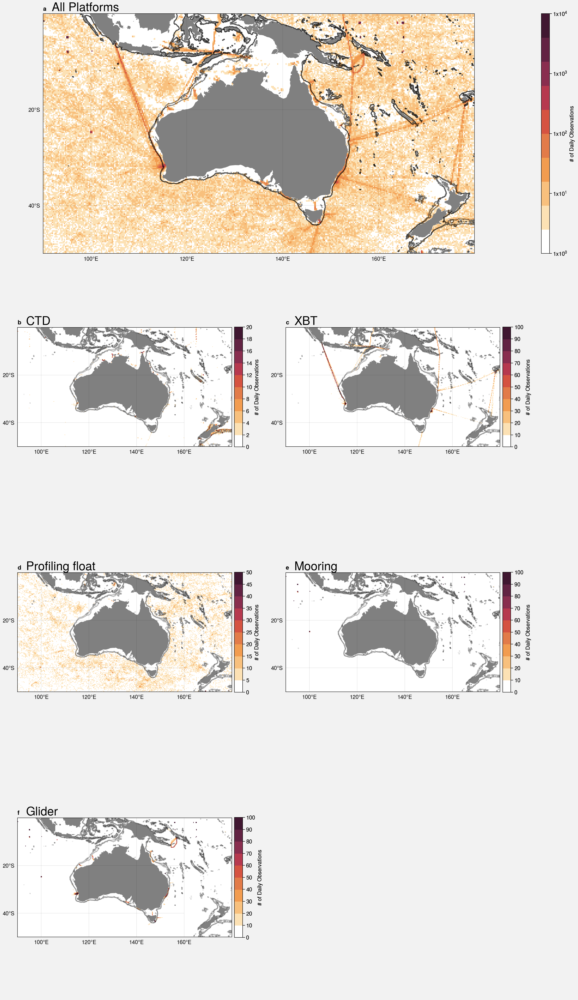

In [11]:
import matplotlib.colors as colors

LONGITUDE_LIM_EAST = 180
LONGITUDE_LIM_WEST = 90

LATITUDE_LIM_SOUTH = -50
LATITUDE_LIM_NORTH = 0 
pplt.rc.reso = 'med'  # use higher res for zoomed in geographic features
#basemap = pplt.Proj('cyl', lonlim=(LONGITUDE_LIM_WEST, LONGITUDE_LIM_EAST), latlim=(LATITUDE_LIM_SOUTH, LATITUDE_LIM_NORTH), basemap=True)

#    fig, axs = pplt.subplots(nrows=1, proj=('cyl'),axwidth=20)
#    axs.format(
#        land=True, labels=True, lonlines=20, latlines=20,
#        gridminor=True,landcolor='grey', abc='a)'
#   )


obs_type_label = ['CTD','XBT','Profiling float','Mooring','Glider']
image_layout = [[1, 1], [2, 3],[4,5],[6,0]]
fig, axs = pplt.subplots(image_layout, proj=('cyl'),axwidth=10,wspace=1)
    
axs.format(
    land=True, labels=True, lonlines=20, latlines=20,
    gridminor=False,landcolor='grey', abc='a)' )

daily_obs_in_cell = obs_count_histogram>=1
total_daily_obs   = daily_obs_in_cell.sum(axis=0).sum(axis=0)
#total_daily_obs[total_daily_obs==0] = 1.0e-15

cs_2d_hist = axs[0].pcolormesh(lon_grid[1::],lat_grid[1::],np.log10(total_daily_obs),cmap='Fire',vmin=0,vmax=4) #,norm=colors.LogNorm(1.0e-15, 1e3))
axs[0].contour(topo['x'],topo['y'],-topo,levels=[200,500],colors='black',alpha=0.5)

axs[0].format(lonlim=(90, 180), latlim=(-50, 0), labels=True)
axs[0].annotate('All Platforms', xy=(0.02, 1.01), xycoords="axes fraction",fontsize=20)
#cbar_obj = axs[0].colorbar(cs_2d_hist, loc='r',ticks=[0,1,2,3,4])


cbar_obj = fig.colorbar(cs_2d_hist, loc='r',ticks=[0,1,2,3,4], row=1,label='# of Daily Observations')
cbar_obj.ax.set_yticklabels([r'1x10$^{0}$',r'1x10$^{1}$', r'1x10$^{2}$', r'1x10$^{3}$', r'1x10$^{4}$'])

max_cmap_value = [20,100,50,100,100]


for i_obs_type in range(0,len(obs_type_label)):
    print('Getting obs type: ', obs_type_label[i_obs_type])
    daily_obs_in_cell_by_obs_type = obs_count_histogram[i_obs_type,:,:,:]>=1
    


    cs_2d_hist = axs[i_obs_type+1].pcolormesh(lon_grid[1::],lat_grid[1::],np.sum(daily_obs_in_cell_by_obs_type,axis=0),cmap='Fire',vmin=0,vmax=max_cmap_value[i_obs_type])
    axs[i_obs_type+1].contour(topo['x'],topo['y'],-topo,levels=[200,500],colors='black',alpha=0.25)

    axs[i_obs_type+1].format(lonlim=(90, 180), latlim=(-50, 0), labels=True)
    axs[i_obs_type+1].colorbar(cs_2d_hist, loc='r',length=0.5,label='# of Daily Observations')
    axs[i_obs_type+1].annotate(obs_type_label[i_obs_type], xy=(0.04, 1.02), xycoords="axes fraction",fontsize=20)

#cbar_obj = fig.colorbar(cs_hist_object[0], loc='r',row=1)#,col=col_counter)
figure_path = './Figures'
figure_name = 'WOD_daily_2D_mapped_histogram_for_all_obs_type'                                                
print(figure_name)
fig.savefig(os.path.join(figure_path,figure_name + '.png'), dpi=400)


In [13]:
np.arange(np.datetime64(str(START_YEAR) + "-01-01"), np.datetime64(str(END_YEAR+1) + "-01-01"), np.timedelta64(365, "D"))

array(['2005-01-01', '2006-01-01', '2007-01-01', '2008-01-01',
       '2008-12-31', '2009-12-31', '2010-12-31', '2011-12-31',
       '2012-12-30', '2013-12-30', '2014-12-30', '2015-12-30',
       '2016-12-29', '2017-12-29', '2018-12-29', '2019-12-29',
       '2020-12-28'], dtype='datetime64[D]')

In [43]:
date_range.size

13

In [67]:
data_container_for_year[i_obs_type]['lon'].sel(casts=casts_in_box)

<xarray.DataArray 'lon' (casts: 89687)>
array([155.98344, 156.02255, 156.0603 , ..., 154.50954, 154.50415, 154.5124 ],
      dtype=float32)
Coordinates:
    lat      (casts) float32 -9.233 -9.194 -9.151 ... -12.24 -12.19 -12.14
    lon      (casts) float32 156.0 156.0 156.1 156.1 ... 154.5 154.5 154.5 154.5
    time     (casts) datetime64[ns] ...
Dimensions without coordinates: casts
Attributes:
    standard_name:  longitude
    long_name:      longitude
    units:          degrees_east

Profiling float
XBT
Glider
Mooring
CTD
WOD_data_australia_total_by_time


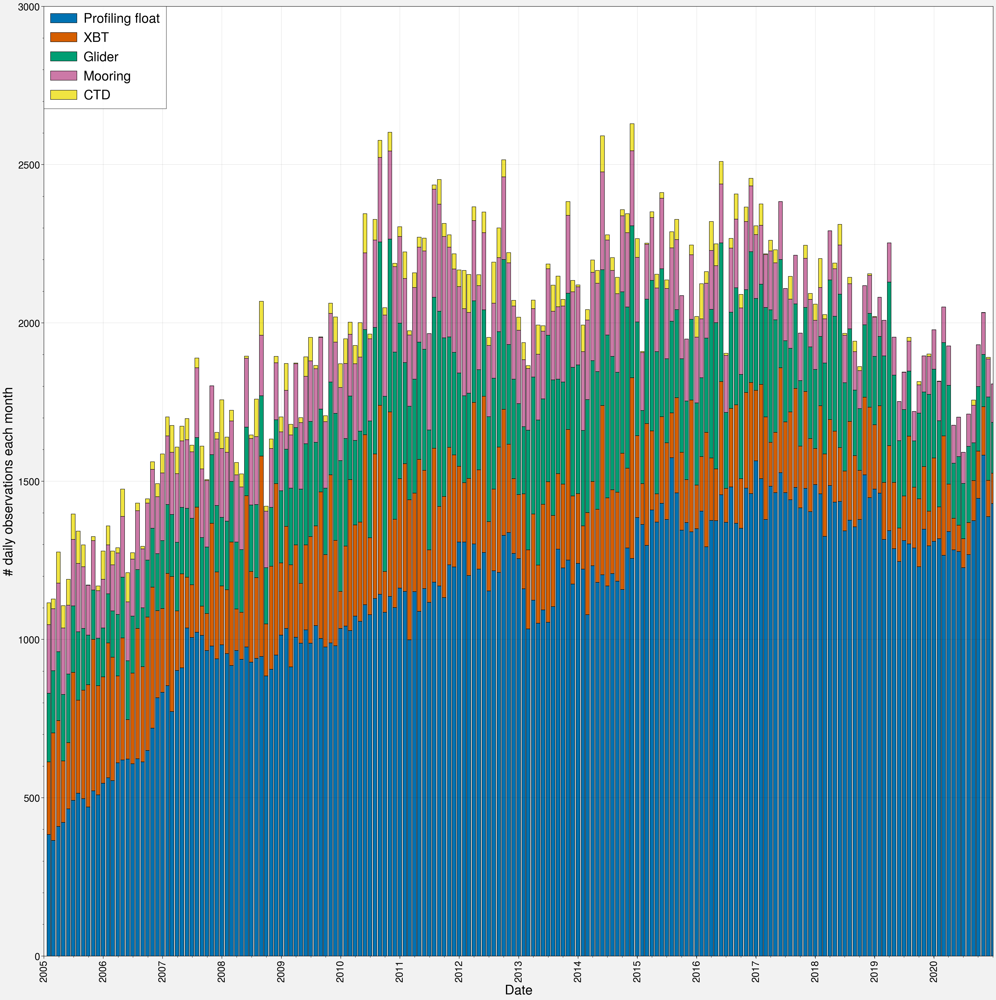

In [67]:
import proplot as pplt
from scipy import stats as scipy_stats
import matplotlib.dates as mdates

LONGITUDE_LIM_EAST = 180
LONGITUDE_LIM_WEST = 90

LATITUDE_LIM_SOUTH = -50
LATITUDE_LIM_NORTH = 0 
#obs_type = ['ctd','xbt','pfl','osd','mrb','gld','drb'] #,'gld']

proplot.rc.reso = 'med'  # use higher res for zoomed in geographic features
#basemap = pplt.Proj('cyl', lonlim=(-20, 180), latlim=(-10, 50), basemap=True)
fig, axs = proplot.subplots(nrows=1, proj=None,axwidth=20)
#axs.format(
#    land=True, labels=True, lonlines=20, latlines=20,
#    gridminor=True,landcolor='grey' 
#)
#proplot.rc['fontsmall'] = 15 
#proplot.rc['fontsmall'] = 15 


obs_type_label   = ['CTD','XBT','Profiling float','Mooring','Glider']
obs_type_to_plot = [2,1,4,3,0]
#obs_type_to_plot = [0,1] #,3,4]

date_range  = np.arange(np.datetime64(str(START_YEAR) + "-01-01"), np.datetime64(str(END_YEAR+1) + "-01-01"), np.timedelta64(1, "D"))
date_bins   = date_range[0:-1] + 0.5*(date_range[0:-1] - date_range[1::])

#date_range      = np.arange(np.datetime64("2018-01-01"), np.datetime64("2019-01-01"), np.timedelta64(15, "D"))
obs_count_histogram
for i_obs_type in obs_type_to_plot:
    print(obs_type_label[i_obs_type])

    daily_obs_in_cell_by_obs_type = obs_count_histogram[i_obs_type,:,:,:]>=1
    total_daily_obs_in_domain     = np.sum(daily_obs_in_cell_by_obs_type,axis=(1,2) )
    
    #total_daily_obs_in_domain_da = xarray.DataArray(total_daily_obs_in_domain,dims=['time'],coords={'time':date_bins})
    #dsa
    
    
    total_daily_obs_in_domain = pandas.Series(total_daily_obs_in_domain, index=date_bins)
    monthly_total = total_daily_obs_in_domain.resample('M', convention='start').sum()



    
    
    if i_obs_type == obs_type_to_plot[0]:
        
        axs[0].bar(monthly_total.index,monthly_total,label=obs_type_label[i_obs_type])
        running_total = monthly_total
    else:
        axs[0].bar(monthly_total.index,monthly_total,label=obs_type_label[i_obs_type],bottom=running_total)
        running_total = running_total+monthly_total

plt.legend(loc='upper left',ncols=1,fontsize=20)
axs[0].set_ylim([0,3000])
axs[0].xaxis.set_major_locator(mdates.YearLocator())
axs[0].xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
axs[0].tick_params(axis='both', which='major', labelsize=15)
#axs[0].tick_params(axis='both', which='major', labelsize=20)

#axs[0].set_yticks(pandas.date_range(start=str(START_YEAR-1) + '-01-01',end=str(END_YEAR+1) + '-01-01',freq='Y',closed='right') )
#axs[0].set_yticklabels(np.arange(np.datetime64(str(START_YEAR) + "-01-01"), np.datetime64(str(END_YEAR+1) + "-01-01"), np.timedelta64(365, "D")),fontsize=15)

axs[0].set_xlim(date_bins[0],date_bins[-1])

axs[0].set_ylabel('# daily observations each month',fontsize=20)
axs[0].set_xlabel('Date',fontsize=20)

figure_path = './Figures'
figure_name = 'WOD_data_australia_total_by_time'                                                
print(figure_name)
fig.savefig(os.path.join(figure_path,figure_name + '.png'), dpi=400)



Profiling float
XBT
Glider
Mooring
CTD
WOD_data_australia_total_monthly_cycle


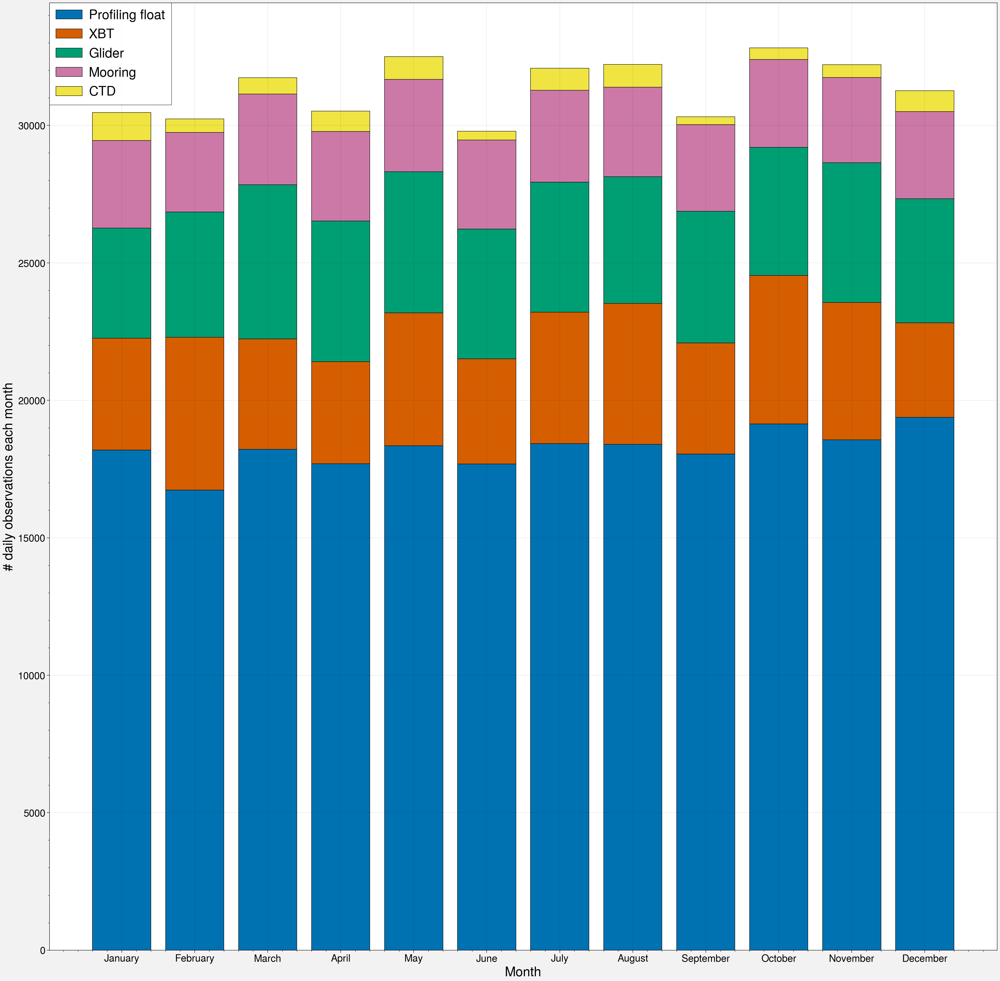

In [74]:
from scipy import stats as scipy_stats

LONGITUDE_LIM_EAST = 180
LONGITUDE_LIM_WEST = 90

LATITUDE_LIM_SOUTH = -50
LATITUDE_LIM_NORTH = 0 

proplot.rc.reso = 'med'  # use higher res for zoomed in geographic features
fig, axs = proplot.subplots(nrows=1, proj=None,axwidth=20)

obs_type_label   = ['CTD','XBT','Profiling float','Mooring','Glider']
obs_type_to_plot = [2,1,4,3,0]
#obs_type_to_plot = [0,1] #,3,4]

date_range  = np.arange(np.datetime64(str(START_YEAR) + "-01-01"), np.datetime64(str(END_YEAR+1) + "-01-01"), np.timedelta64(1, "D"))
date_bins   = date_range[0:-1] + 0.5*(date_range[0:-1] - date_range[1::])

#date_range      = np.arange(np.datetime64("2018-01-01"), np.datetime64("2019-01-01"), np.timedelta64(15, "D"))
obs_count_histogram
for i_obs_type in obs_type_to_plot:
    print(obs_type_label[i_obs_type])

    daily_obs_in_cell_by_obs_type = obs_count_histogram[i_obs_type,:,:,:]>=1
    total_daily_obs_in_domain     = np.sum(daily_obs_in_cell_by_obs_type,axis=(1,2) )
    
    total_daily_obs_in_domain_da = xarray.DataArray(total_daily_obs_in_domain,dims=['time'],coords={'time':date_bins})
    monthly_obs_cycle = total_daily_obs_in_domain_da.groupby('time.month').sum(dim='time')
    
    
    
    #total_daily_obs_in_domain = pandas.Series(total_daily_obs_in_domain, index=date_bins)
    #monthly_total = total_daily_obs_in_domain.resample('M', convention='start').sum()



    
    
    if i_obs_type == obs_type_to_plot[0]:
        
        axs[0].bar(monthly_obs_cycle['month'],monthly_obs_cycle,label=obs_type_label[i_obs_type])
        running_total = monthly_obs_cycle
    else:
        axs[0].bar(monthly_obs_cycle['month'],monthly_obs_cycle,label=obs_type_label[i_obs_type],bottom=running_total)
        running_total = running_total+monthly_obs_cycle

plt.legend(loc='upper left',ncols=1,fontsize=20)
axs[0].tick_params(axis='both', which='major', labelsize=15)
#axs[0].tick_params(axis='both', which='major', labelsize=20)

axs[0].set_xticks(np.arange(1,13,1))
axs[0].set_xticklabels(['January','February','March','April','May','June','July','August','September','October','November','December'])

#axs[0].set_yticklabels(np.arange(np.datetime64(str(START_YEAR) + "-01-01"), np.datetime64(str(END_YEAR+1) + "-01-01"), np.timedelta64(365, "D")),fontsize=15)

#axs[0].set_xlim(date_bins[0],date_bins[-1])

axs[0].set_ylabel('# daily observations each month',fontsize=20)
axs[0].set_xlabel('Month',fontsize=20)

figure_path = './Figures'
figure_name = 'WOD_data_australia_total_monthly_cycle'                                                
print(figure_name)
fig.savefig(os.path.join(figure_path,figure_name + '.png'), dpi=400)



Profiling float
XBT
Glider
Mooring
CTD
WOD_data_australia_total_yearly_total


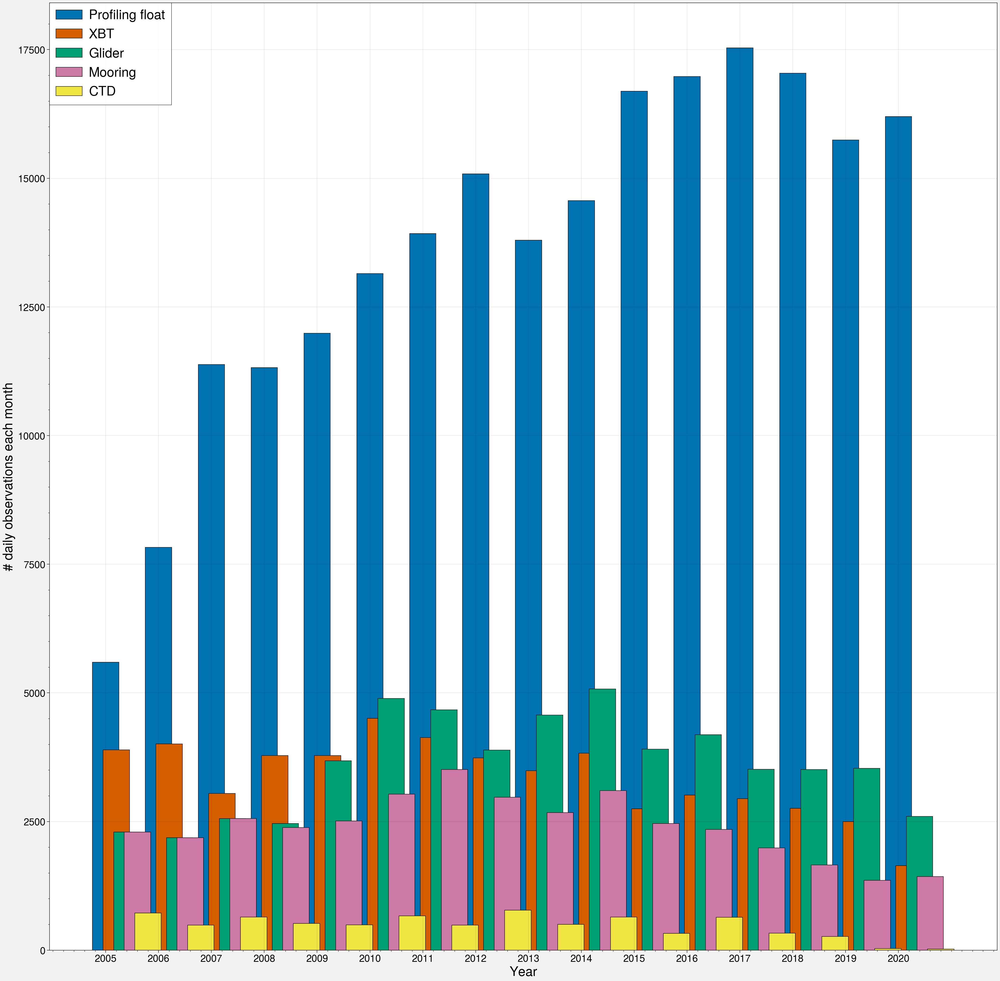

In [80]:
from scipy import stats as scipy_stats

LONGITUDE_LIM_EAST = 180
LONGITUDE_LIM_WEST = 90

LATITUDE_LIM_SOUTH = -50
LATITUDE_LIM_NORTH = 0 

proplot.rc.reso = 'med'  # use higher res for zoomed in geographic features
fig, axs = proplot.subplots(nrows=1, proj=None,axwidth=20)

obs_type_label   = ['CTD','XBT','Profiling float','Mooring','Glider']
obs_type_to_plot = [2,1,4,3,0]
#obs_type_to_plot = [0,1] #,3,4]

date_range  = np.arange(np.datetime64(str(START_YEAR) + "-01-01"), np.datetime64(str(END_YEAR+1) + "-01-01"), np.timedelta64(1, "D"))
date_bins   = date_range[0:-1] + 0.5*(date_range[0:-1] - date_range[1::])

#date_range      = np.arange(np.datetime64("2018-01-01"), np.datetime64("2019-01-01"), np.timedelta64(15, "D"))
counter= 0
for i_obs_type in obs_type_to_plot:
    print(obs_type_label[i_obs_type])

    daily_obs_in_cell_by_obs_type = obs_count_histogram[i_obs_type,:,:,:]>=1
    total_daily_obs_in_domain     = np.sum(daily_obs_in_cell_by_obs_type,axis=(1,2) )
    
    total_daily_obs_in_domain_da = xarray.DataArray(total_daily_obs_in_domain,dims=['time'],coords={'time':date_bins})
    year_obs_cycle = total_daily_obs_in_domain_da.groupby('time.year').sum(dim='time')
    
    
    
    #total_daily_obs_in_domain = pandas.Series(total_daily_obs_in_domain, index=date_bins)
    #monthly_total = total_daily_obs_in_domain.resample('M', convention='start').sum()



    
    
    if i_obs_type == obs_type_to_plot[0]:
        
        axs[0].bar(year_obs_cycle['year']+(counter*0.2),year_obs_cycle,label=obs_type_label[i_obs_type],width=0.5)
        running_total = year_obs_cycle
    else:
        axs[0].bar(year_obs_cycle['year']+(counter*0.2),year_obs_cycle,label=obs_type_label[i_obs_type],width=0.5) #,bottom=running_total)
        #running_total = running_total+year_obs_cycle
    counter = counter+1
plt.legend(loc='upper left',ncols=1,fontsize=20)
axs[0].tick_params(axis='both', which='major', labelsize=15)
#axs[0].tick_params(axis='both', which='major', labelsize=20)

axs[0].set_xticks(np.arange(START_YEAR,END_YEAR+1,1))
#axs[0].set_xticklabels(['January','February','March','April','May','June','July','August','September','October','November','December'])

#axs[0].set_yticklabels(np.arange(np.datetime64(str(START_YEAR) + "-01-01"), np.datetime64(str(END_YEAR+1) + "-01-01"), np.timedelta64(365, "D")),fontsize=15)

#axs[0].set_xlim(date_bins[0],date_bins[-1])

axs[0].set_ylabel('# daily observations each month',fontsize=20)
axs[0].set_xlabel('Year',fontsize=20)

figure_path = './Figures'
figure_name = 'WOD_data_australia_total_yearly_total'                                                
print(figure_name)
fig.savefig(os.path.join(figure_path,figure_name + '.png'), dpi=400)


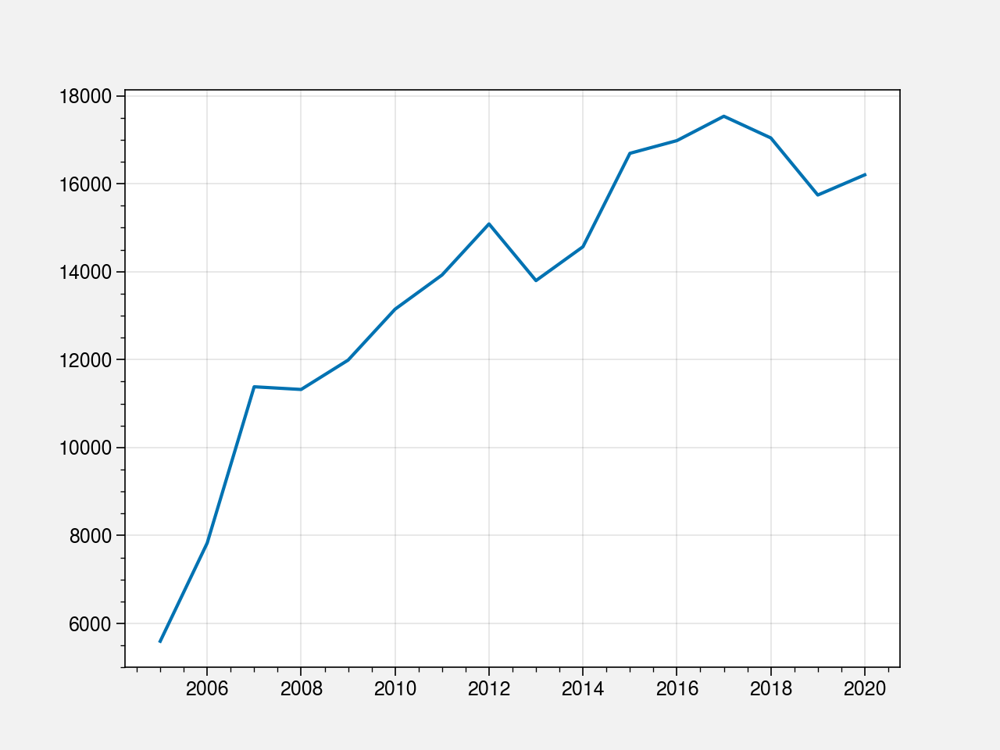

In [66]:
plt.plot(blah['year'],blah.values)

In [62]:
blah

<xarray.DataArray (month: 12)>
array([18191, 16739, 18217, 17689, 18346, 17687, 18427, 18395, 18044,
       19140, 18565, 19378])
Coordinates:
  * month    (month) int64 1 2 3 4 5 6 7 8 9 10 11 12

In [48]:
monthly_total.index

DatetimeIndex(['2005-01-31', '2005-02-28', '2005-03-31', '2005-04-30',
               '2005-05-31', '2005-06-30', '2005-07-31', '2005-08-31',
               '2005-09-30', '2005-10-31',
               ...
               '2020-03-31', '2020-04-30', '2020-05-31', '2020-06-30',
               '2020-07-31', '2020-08-31', '2020-09-30', '2020-10-31',
               '2020-11-30', '2020-12-31'],
              dtype='datetime64[ns]', length=192, freq='M')

In [57]:
monthly_total

In [49]:
date_bins

array(['2005-01-01', '2005-01-02', '2005-01-03', ..., '2020-12-28',
       '2020-12-29', '2020-12-30'], dtype='datetime64[D]')

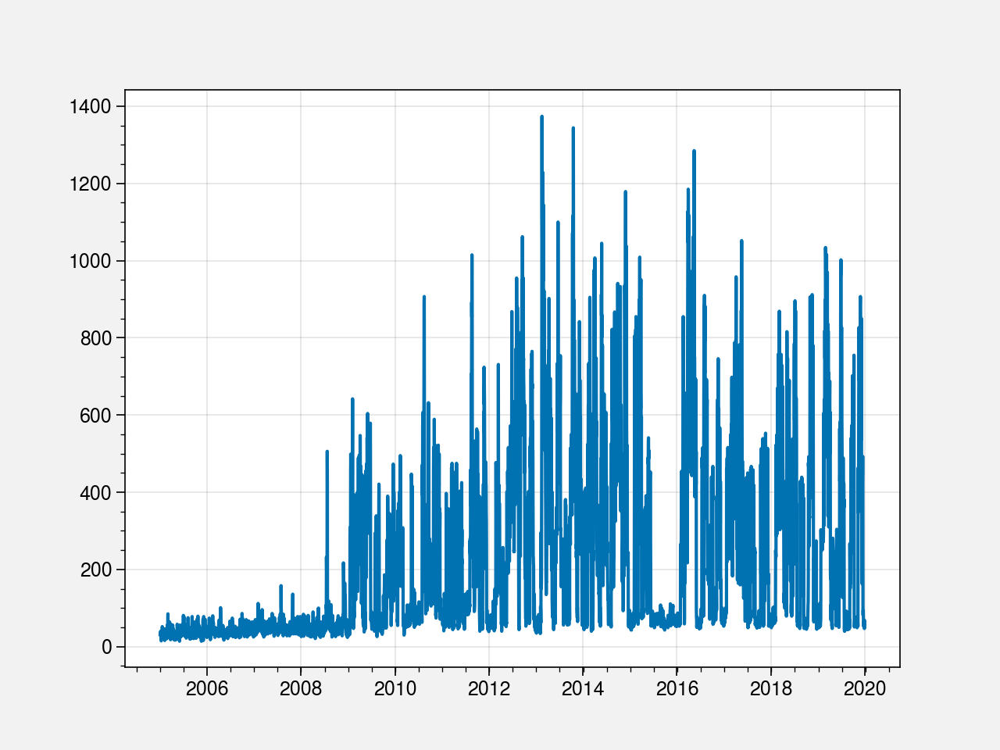

In [59]:
plt.plot(date_range[1::],obs_count_histogram.sum(axis=2).sum(axis=1) )

In [60]:
np.unique(data_container_for_year[i_obs_type]['WOD_cruise_identifier'].values)

array([b'AU005779', b'AU005780', b'AU005781', b'AU005782', b'AU005783',
       b'AU006197', b'AU006198', b'AU006199', b'AU006200', b'AU006201',
       b'AU006202', b'AU006203', b'AU006204', b'AU006205', b'AU006206',
       b'AU006207', b'AU006208', b'AU006209', b'AU006210', b'AU006211',
       b'AU006213', b'AU006214', b'AU006215', b'AU006216', b'AU006311',
       b'CA020422', b'CA020423', b'CA020433', b'CA020548', b'CA020549',
       b'CA020550', b'CA020551', b'CA020552', b'CA020553', b'CA020555',
       b'CA020583', b'CA020584', b'CA020585', b'CA020609', b'CA020610',
       b'CA020611', b'CA020616', b'CA020617', b'CA020637', b'CA020638',
       b'CY000080', b'DE012667', b'DE012678', b'DE012684', b'DE012708',
       b'DE012720', b'DE012728', b'ES001657', b'ES001658', b'ES001659',
       b'FR016748', b'FR016749', b'FR016750', b'FR016760', b'FR016812',
       b'FR016813', b'FR016814', b'FR016824', b'FR016825', b'FR016950',
       b'GB013370', b'GB013402', b'GB013413', b'GR000740', b'IE0

<BarContainer object of 24 artists>

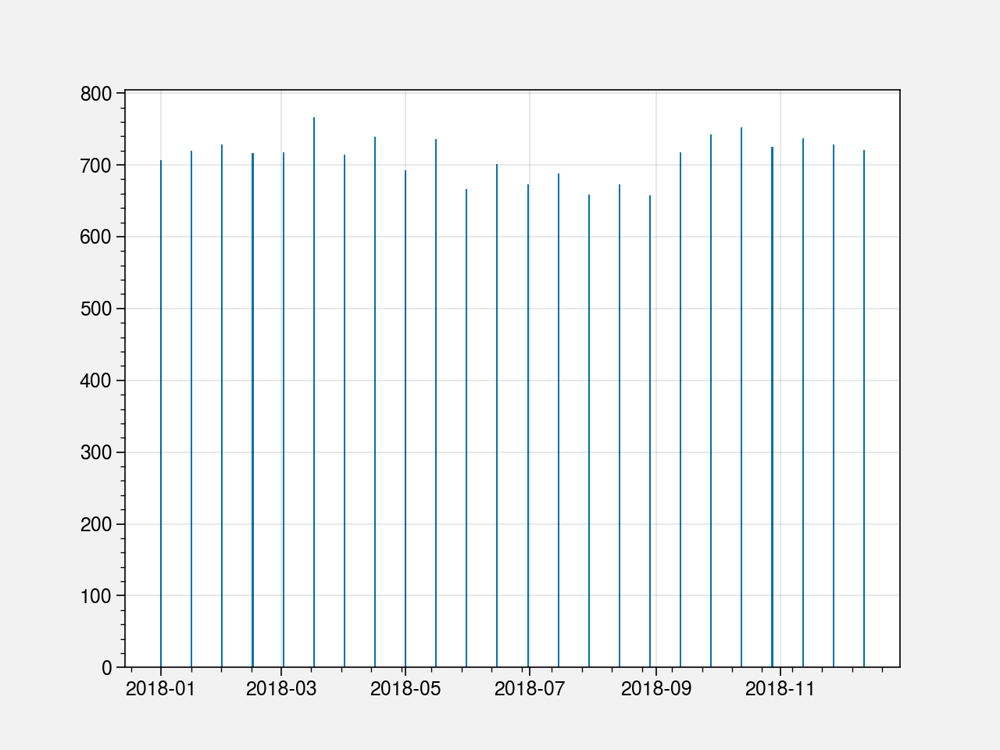

In [68]:

plt.bar(bin_edges[0:-1],hist)

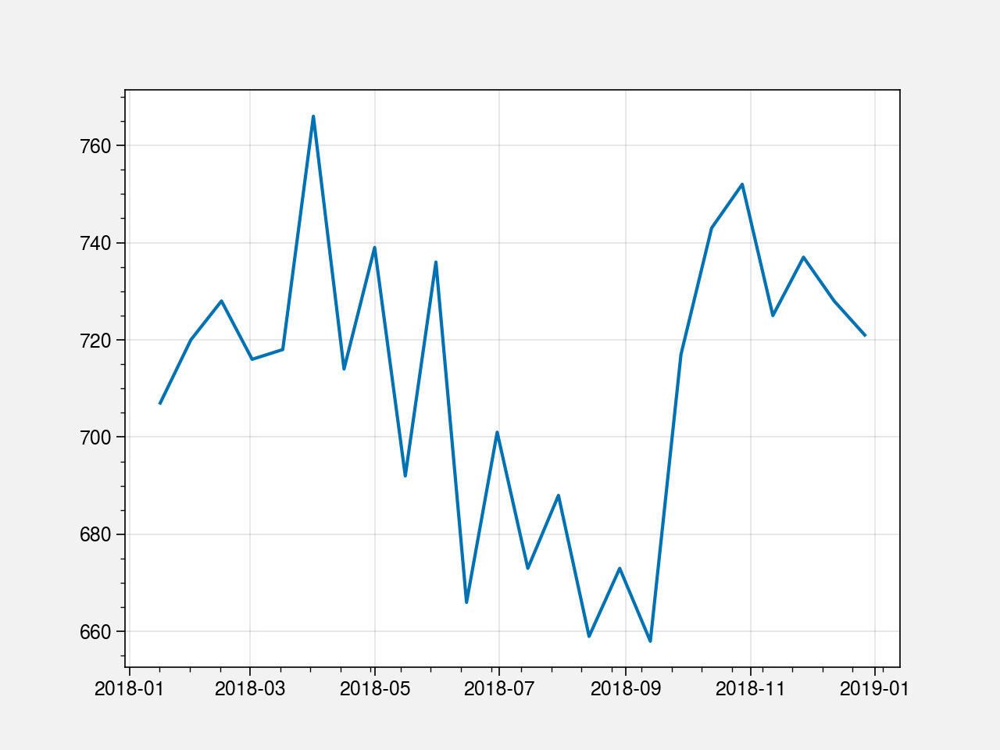

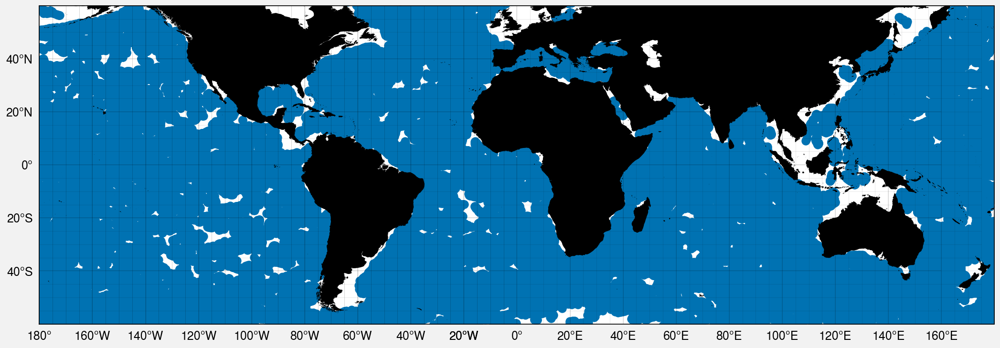

In [15]:
i_obs_type=2
pplt.rc.reso = 'med'  # use higher res for zoomed in geographic features
#basemap = pplt.Proj('cyl', lonlim=(-20, 180), latlim=(-10, 50), basemap=True)
fig, axs = pplt.subplots(nrows=1, proj=('cyl'),axwidth=10)
axs.format(
    land=True, labels=True, lonlines=20, latlines=20,
    gridminor=True, 
)



#for i_cast in range(0, casts_in_box.size):
#    cast_number = casts_in_box[i_cast]
    #print(cast_number.values)
#latitude_profile = data_container_for_year[i_obs_type]['lat'].sel(casts=casts_in_box)
#longitude_profile = data_container_for_year[i_obs_type]['lon'].sel(casts=casts_in_box)
axs[0].scatter(data_container_for_year[i_obs_type]['lon'],data_container_for_year[i_obs_type]['lat']) #,label=str(cast_number.values)) #,latitude_for_casts)
axs[0].format(lonlim=(0, 360), latlim=(-60, 60), labels=True)



#data_container_for_year[i_obs_type]['lat']

In [11]:
casts_in_box

<xarray.DataArray 'casts' (casts: 15096)>
array([     6,     12,     19, ..., 176806, 176809, 176839])
Coordinates:
    lat      (casts) float32 -17.82 -15.88 -18.11 ... -33.01 -41.05 -15.96
    lon      (casts) float32 158.8 92.25 104.5 166.5 ... 162.1 166.4 95.5 115.7
    time     (casts) datetime64[ns] 2018-01-01T00:59:02.760264704 ... 2018-12...
Dimensions without coordinates: casts

In [26]:
ds_subset = ds.where(ds['lat']>=LATITUDE_LIM_SOUTH) & (ds['lat']<=LATITUDE_LIM_NORTH) & (ds['lon']>=LONGITUDE_LIM_WEST) & (ds['lon']<=LONGITUDE_LIM_EAST)


KeyboardInterrupt



In [94]:
test_casts = ds['casts'].where(ds['lat']<=LATITUDE_LIM_NORTH,drop=True ) 
test = ds.sel(casts=test_casts['casts'])



In [99]:
test['casts']


<xarray.DataArray 'casts' (casts: 89124)>
array([    0,     1,     2, ..., 89121, 89122, 89123])
Coordinates:
    lat      (casts) float32 63.98 -50.1 -60.06 44.94 ... 44.16 -31.19 -42.26
    lon      (casts) float32 -55.93 -174.7 -133.8 -132.2 ... 31.21 35.53 -12.61
    time     (casts) datetime64[ns] 2018-01-01T00:28:08.040089600 ... 2018-07...
Dimensions without coordinates: casts

In [100]:
test_casts

<xarray.DataArray 'casts' (casts: 89124)>
array([1.00000e+00, 2.00000e+00, 6.00000e+00, ..., 1.76835e+05,
       1.76837e+05, 1.76840e+05])
Coordinates:
    lat      (casts) float32 -50.1 -60.06 -17.82 ... -15.96 -10.28 -0.8546
    lon      (casts) float32 -174.7 -133.8 158.8 -168.0 ... 115.7 -172.6 -6.025
    time     (casts) datetime64[ns] 2018-01-01T00:16:51.959910400 ... 2018-12...
Dimensions without coordinates: casts

In [86]:
test_lat.max()

<xarray.DataArray 'lat' ()>
array(-0.001)

In [76]:
#test_latitude_for_casts = ds['lat'].sel(casts=test_casts['casts'])


In [83]:
print(test_latitude_for_casts.max())
print(ds['lat'].max())


<xarray.DataArray 'lat' ()>
array(81.99629211)
<xarray.DataArray 'lat' ()>
array(82.79761505)


In [39]:
#temperature_for_cast  = ds['Temperature'].where(np.isin(ds['Temperature_cast_index'], [20,21,22]),drop=True)

#temperature_for_cast  = ds['Temperature'].where(ds['Temperature_cast_index']==20,drop=True)
temperature_casts_to_get  = ds['Temperature_cast_index'].isin([20,30,40])
temperature_for_casts     = ds['Temperature'][temperature_casts_to_get]
temperature_cast_index_for_cast    = ds['Temperature_cast_index'][temperature_casts_to_get]

z_casts_to_get         = ds['z_cast_index'].isin([20,30,40])
z_for_casts            = ds['z'][z_casts_to_get]
z_cast_index_for_cast  = ds['z_cast_index'][z_casts_to_get]

#cast_idx_to_get = ds['Temperature_cast_index'][temperature_casts_to_get]


#z_idx_to_get = ds['z'][z_casts_to_get]

#isin([1, 3])


In [35]:
import proplot as pplt

# Plate Carrée map projection
pplt.rc.reso = 'med'  # use higher res for zoomed in geographic features
#basemap = pplt.Proj('cyl', lonlim=(-20, 180), latlim=(-10, 50), basemap=True)
fig, axs = pplt.subplots(nrows=1, proj=('cyl'),axwidth=10)
axs.format(
    land=True, labels=True, lonlines=20, latlines=20,
    gridminor=True, 
)
axs[0].format(lonlim=(90, 180), latlim=(-50, 0), labels=True)
axs[0].scatter(ds['lon'],ds['lat'])

#axs[0].format(title='Cartopy example')
#axs[1].format(title='Basemap example')


<xarray.DataArray 'Temperature_cast_index' (Temperature_obs: 651)>
array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
...
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])
Dimensions without coordinates: Temperature_obs

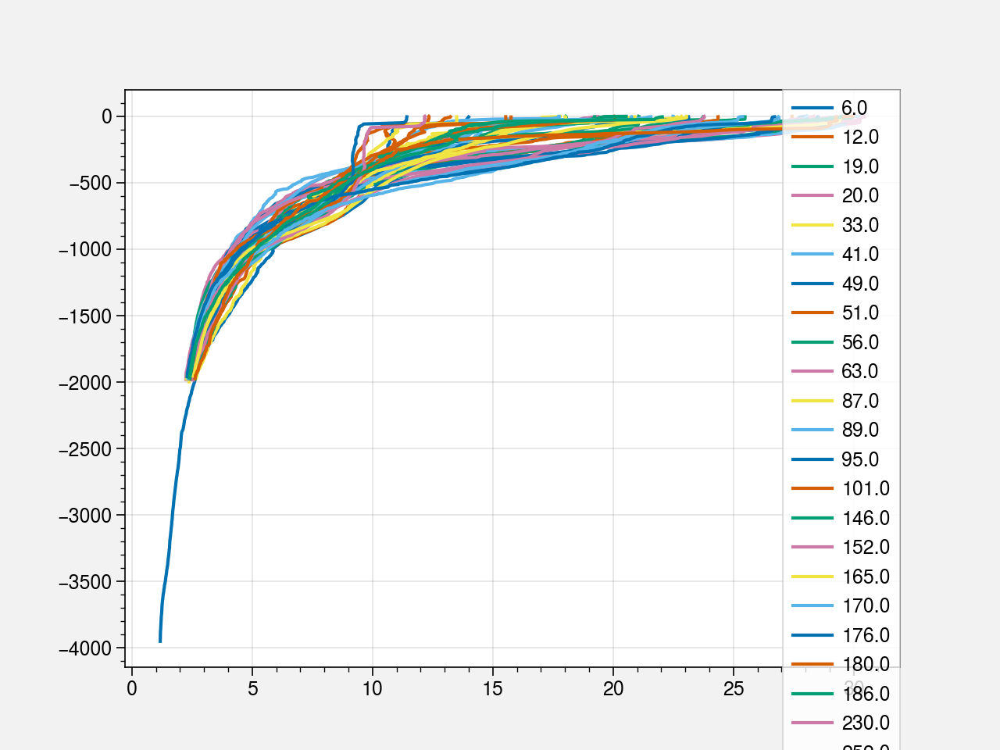

In [52]:
counter =0 

for cast_number in meets_condition_casts:
    T_profile = temperature_for_casts[temperature_cast_index_for_cast==cast_number]
    Z_profile = z_for_casts[z_cast_index_for_cast ==cast_number ]
    #temperature_for_cast  = ds['Temperature'][cast_idx_to_get==cast_number]
    #z_for_cast  = ds['z'][z_idx_to_get==cast_number]

    #pressure = ds['Pressure'][start_pressure_index:start_pressure_index+end_pressure_index]
    plt.plot(T_profile,-Z_profile,label=str(cast_number.values))
    counter = counter + 1
    
    if counter > 50:
        break
plt.legend()

In [68]:
start_oxy_index = ds['Oxygen_row_size'].cumsum().astype(int).values
start_oxy_index = np.concatenate([np.zeros([1],dtype=int),start_oxy_index])
#end_temp_index   = int(ds['Temperature_row_size'][cast_number])
cast_oxy_index = xr.full_like(ds['Oxygen_obs'],fill_value=0,dtype=int)

for i_cast in range(0,ds['casts'].size):
    
    cast_oxy_index[start_oxy_index[i_cast]:start_oxy_index[i_cast+1]] = i_cast



In [112]:
start_z_index = ds['z_row_size'].cumsum().astype(int).values
start_z_index = np.concatenate([np.zeros([1],dtype=int),start_z_index])
#end_temp_index   = int(ds['Temperature_row_size'][cast_number])
cast_z_index = xr.full_like(ds['z_obs'],fill_value=0,dtype=int)

for i_cast in range(0,ds['casts'].size):
    
    cast_z_index[start_z_index[i_cast]:start_z_index[i_cast+1]] = i_cast



In [115]:
cast_z_index[71]

<xarray.DataArray 'z_obs' ()>
array(0)
Coordinates:
    z        float32 ...

In [109]:
ds['z_row_size']

<xarray.DataArray 'z_row_size' (casts: 165973)>
array([  72.,   72.,   57., ..., 1813.,  723.,  747.])
Coordinates:
    lat      (casts) float32 40.47 17.68 -34.09 46.37 ... 58.98 -14.59 -32.2
    lon      (casts) float32 -133.9 -133.0 32.1 -43.87 ... -52.11 -88.67 96.81
    time     (casts) datetime64[ns] ...
Dimensions without coordinates: casts
Attributes:
    long_name:         number of depth observations for this cast
    sample_dimension:  z_obs

In [110]:
 ds['Temperature_row_size']

<xarray.DataArray 'Temperature_row_size' (casts: 165973)>
array([  72.,   72.,   57., ..., 1813.,  723.,  747.])
Coordinates:
    lat      (casts) float32 40.47 17.68 -34.09 46.37 ... 58.98 -14.59 -32.2
    lon      (casts) float32 -133.9 -133.0 32.1 -43.87 ... -52.11 -88.67 96.81
    time     (casts) datetime64[ns] ...
Dimensions without coordinates: casts
Attributes:
    long_name:         number of Temperature observations for this cast
    sample_dimension:  Temperature_obs

In [87]:
np.unique(cast_oxy_index)[0:5]

array([ 70,  74,  98,  99, 100])

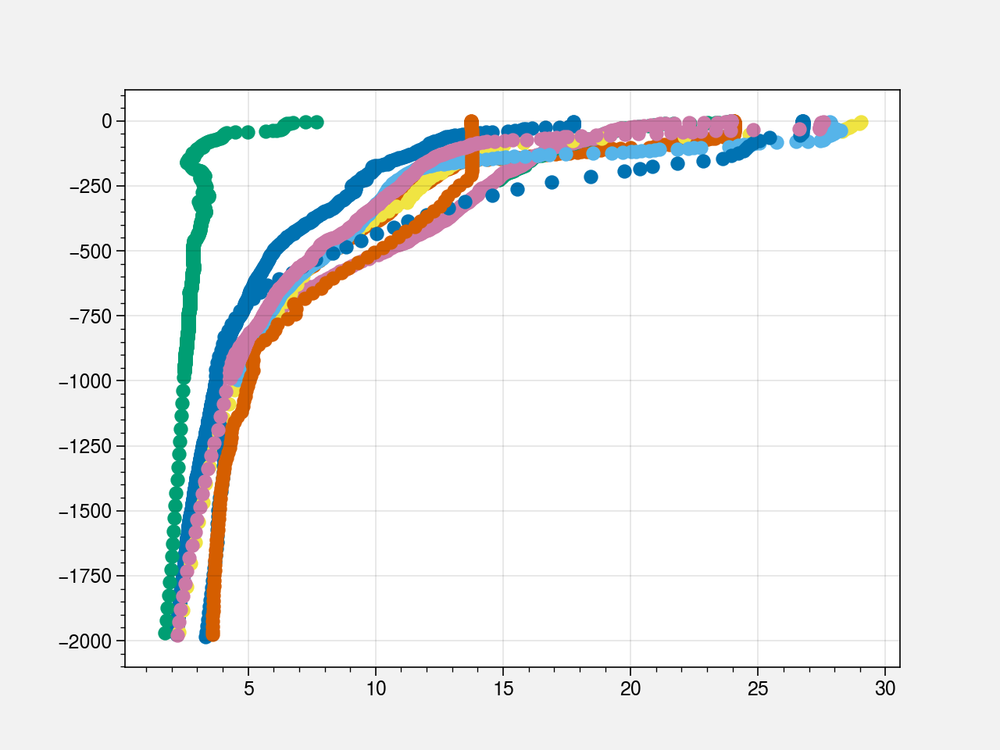

In [135]:
for i_cast in np.unique(cast_temperature_index)[60:70]:

    idx=np.nonzero(cast_temperature_index.values==i_cast)[0]
    idx_depth = np.nonzero(cast_depth_index.values==i_cast)[0]

    plt.scatter(ds['Temperature'][idx],-ds['z'][idx_depth])
#    plt.plot(ds['Temperature'][idx])

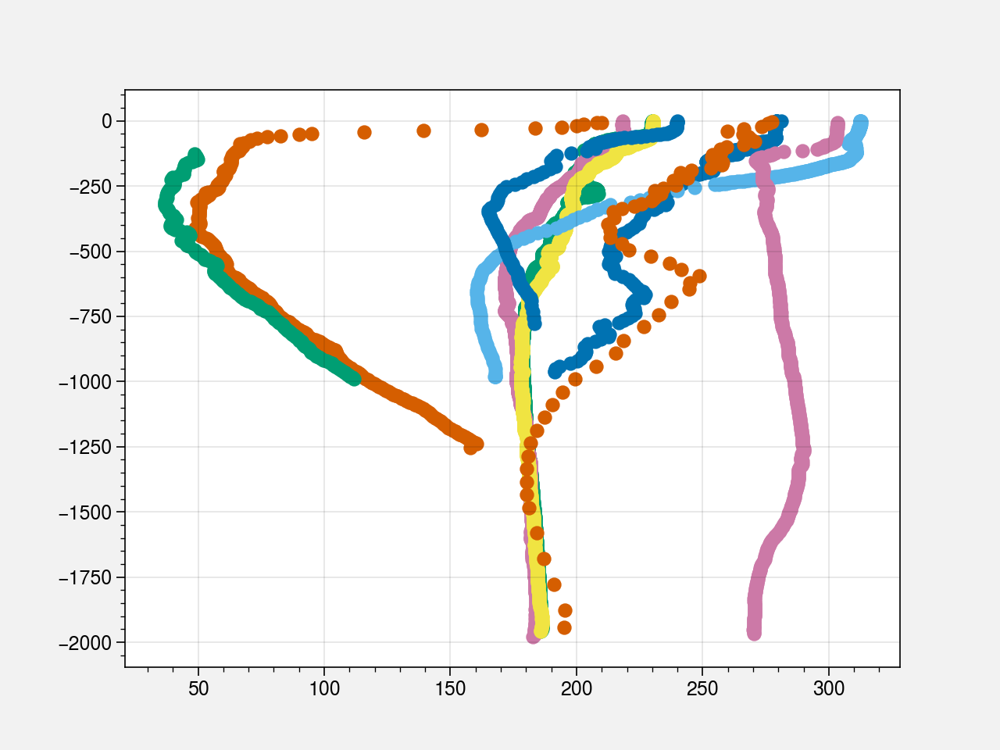

In [120]:
for i_cast in np.unique(cast_oxy_index)[0:10]:

    idx=np.nonzero(cast_oxy_index.values==i_cast)[0]
    idx_depth = np.nonzero(cast_z_index.values==i_cast)[0]
    plt.scatter(ds['Oxygen'][idx],-ds['z'][idx_depth])

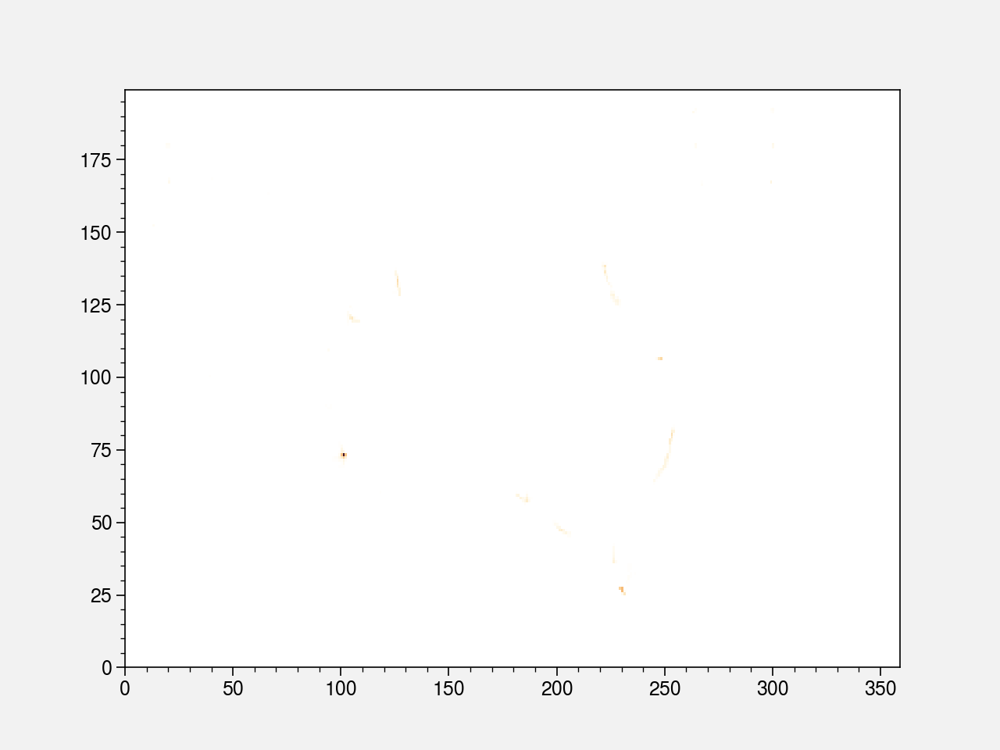

In [49]:
plt.pcolormesh(obs_count_histogram.sum(axis=0))

In [48]:
obs_count_histogram.sum(axis=0).shape

(199, 359)

In [85]:
idx

array([1138, 1139, 1140, ..., 3112, 3113, 3114])

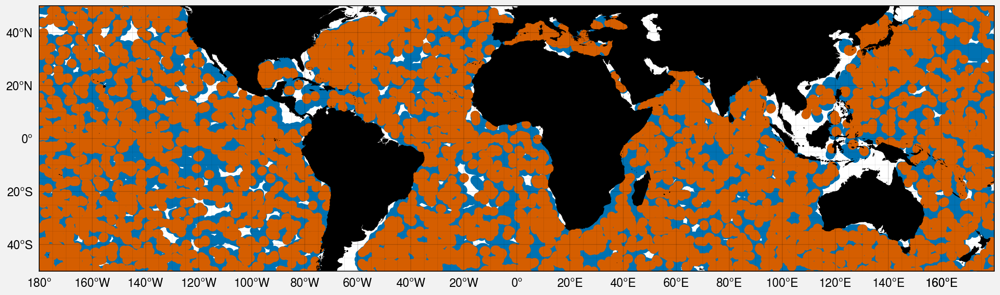

In [59]:
import proplot as pplt

# Plate Carrée map projection
pplt.rc.reso = 'med'  # use higher res for zoomed in geographic features
#basemap = pplt.Proj('cyl', lonlim=(-20, 180), latlim=(-10, 50), basemap=True)
fig, axs = pplt.subplots(nrows=1, proj=('cyl'),axwidth=10)
axs.format(
    land=True, labels=True, lonlines=20, latlines=20,
    gridminor=True, 
)
axs[0].scatter(ds['lon'],ds['lat'])
axs[0].scatter(longitude_for_casts,latitude_for_casts)
axs[0].format(lonlim=(-180, 180), latlim=(-50, 50), labels=True)

#axs[0].format(title='Cartopy example')
#axs[1].format(title='Basemap example')


In [25]:
start_year = 2000
end_year = 2020
years = list(np.arange(start_year, end_year+1, 1))
#months = ["01", "02", "03", "04", "05", "06", "07", "08", "09", "10", "11", "12"]
file_pattern = 's3://noaa-wod-pds/{year}/wod_xbt_{year}.nc'

#@dask.delayed
def s3open(path):
    fs = s3fs.S3FileSystem(anon=True, default_fill_cache=False)
    return fs.open(path)

files_mapper = [s3open(file_pattern.format(year=year)) for year in years]

In [26]:
ds_xbt = xr.open_mfdataset(files_mapper, engine='h5netcdf', concat_dim='time',combine='nested', coords='minimal', compat='override', parallel=False)


ValueError: arguments without labels along dimension 'Temperature_obs' cannot be aligned because they have different dimension sizes: {25025034, 24700693, 17596952, 18817304, 19402916, 3983412, 21561912, 23723837, 26610368, 18349507, 22787931, 15139165, 24026592, 23369572, 19985771, 21364846, 20986862, 21457907, 23342583, 25213304, 20585085}

In [24]:
ds_xbt.close()

NameError: name 'ds_xbt' is not defined

In [3]:
#https://noaa-wod-pds.s3.amazonaws.com/index.html#2020/
#https://noaa-wod-pds.s3.amazonaws.com/2020/wod_xbt_2020.nc
#s3://cmip6-pds/CMIP6/ScenarioMIP/NOAA-GFDL/GFDL-ESM4/ssp119/r1i1p1f1/day/tas/gr1/v20180701/
url = 's3://noaa-wod-pds/2020/wod_xbt_2020.nc'
ncfile = fsspec.open(url)

#ncfile = fsspec.open(url)
ds = xr.open_dataset(ncfile.open())

#ds.air_temperature_at_2_metres.encoding

#files_mapper = [s3open('s3://noaa-wod-pds/2020')]
#ds = xr.open_mfdataset(files_mapper, engine='scipy', parallel=False)

ConnectTimeoutError: Connect timeout on endpoint URL: "http://169.254.169.254/latest/api/token"

In [14]:
s3open('s3://noaa-wod-pds')